In [157]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage import filters, morphology, measure, exposure
from skimage.filters import frangi
from sklearn.metrics import confusion_matrix, accuracy_score
from skimage.measure import regionprops
import os
import glob
from PIL import Image

In [158]:
plt.rcParams['figure.figsize'] = (15, 10)
plt.rcParams['font.size'] = 12

IMAGES_DIR = 'images'
MASKS_DIR = 'mask'
MANUAL_DIR = 'manual1'

In [162]:
# Dodaj ten import na górze pliku:
# from skimage.measure import regionprops

class BloodVesselDetector:
    def __init__(self):
        self.frangi_params = {
            'sigmas': range(1, 12, 1),  # Przywrócono oryginalny zakres
            'alpha': 0.3,               # Przywrócono oryginalne
            'beta': 0.2,                # Przywrócono oryginalne  
            'gamma': 25,                # Przywrócono oryginalne
            'black_ridges': True
        }
    
    def load_image(self, image_path):
        return cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
    
    def load_mask(self, mask_path):
        return cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    
    def preprocess_image(self, image, mask=None):
        if len(image.shape) == 3:
            gray = image[:,:,1]
        else:
            gray = image.copy()
            
        # Przywrócono oryginalne CLAHE
        clahe = cv2.createCLAHE(clipLimit=3.5, tileGridSize=(8,8))
        gray_eq = clahe.apply(gray)
        
        # Przywrócono oryginalne filtrowanie Kirsch
        filtered = self.kirsch_filter(gray_eq)
        enhanced = cv2.add(gray_eq, filtered.astype(np.uint8))
        
        # Przywrócono oryginalne kernele morfologiczne
        kernel_tophat = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (25,25))
        tophat = cv2.morphologyEx(gray_eq, cv2.MORPH_TOPHAT, kernel_tophat)
        blackhat = cv2.morphologyEx(gray_eq, cv2.MORPH_BLACKHAT, kernel_tophat)
        enhanced = cv2.add(tophat, blackhat)
        
        # Przywrócono oryginalne denoising
        denoised = cv2.bilateralFilter(enhanced, 5, 40, 40)
            
        if mask is not None:
            denoised = cv2.bitwise_and(denoised, denoised, mask=mask)

        return denoised
        
    def detect_vessels_frangi(self, preprocessed_image):
        print("DEBUG – kształt preprocessed_image:", preprocessed_image.shape)
        inverted = (255 - preprocessed_image).astype(np.float64) / 255.0
        frangi_response = frangi(
            inverted,
            **self.frangi_params
        )
        
        return frangi_response
    
    def postprocess_vessels(self, frangi_response, threshold=None):
        frangi_norm = (frangi_response * 255).astype(np.uint8)
        
        if threshold is None:
            # Delikatnie wyższy percentyl - kompromis
            binary = self.threshold_percentile(frangi_response, pct=87)
        elif threshold == 'percentile':
            binary = self.threshold_percentile(frangi_response, pct=90)
        else:
            _, binary = cv2.threshold((frangi_response * 255).astype(np.uint8), threshold, 255, cv2.THRESH_BINARY)
            
        # Przywrócono oryginalne kernele morfologiczne
        kernel_close = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel_close)
        
        kernel_dilate = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        dilated = cv2.dilate(closed, kernel_dilate, iterations=1)
        
        kernel_erode = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2, 2))
        eroded = cv2.erode(dilated, kernel_erode, iterations=1)
        
        kernel_open = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        opened = cv2.morphologyEx(eroded, cv2.MORPH_OPEN, kernel_open)
        
        # Umiarkowanie większy min_size 
        cleaned = morphology.remove_small_objects(
            opened.astype(bool), 
            min_size=120,  # Zwiększono z 80 do 120 (nie 200)
            connectivity=2
        ).astype(np.uint8) * 255
        
        return cleaned
    
    def process_single_image(self, image_path, mask_path=None, threshold=None):
        image = self.load_image(image_path)
        
        mask = None
        if mask_path and os.path.exists(mask_path):
            mask = self.load_mask(mask_path)
            mask = (mask > 0).astype(np.uint8) * 255
            
        preprocessed = self.preprocess_image(image, mask)
        frangi_response = self.detect_vessels_frangi(preprocessed)
        vessel_mask = self.postprocess_vessels(frangi_response, threshold)
        
        return {
            'original': image,
            'preprocessed': preprocessed,
            'frangi_response': frangi_response,
            'vessel_mask': vessel_mask,
            'eye_mask': mask
        }
    
    def visualize_results(self, results, title="Wyniki wykrywania naczyń", ground_truth_mask=None):
        if ground_truth_mask is not None:
            # Jeśli mamy ground truth, robimy rozszerzoną wizualizację z analizą błędów
            fig, axes = plt.subplots(3, 3, figsize=(18, 18))
            fig.suptitle(title, fontsize=16, fontweight='bold')

            # Rząd 1: Oryginalne obrazy
            axes[0,0].imshow(results['original'])
            axes[0,0].set_title('Oryginalny obraz')
            axes[0,0].axis('off')

            axes[0,1].imshow(results['preprocessed'], cmap='gray')
            axes[0,1].set_title('Po preprocessingu')
            axes[0,1].axis('off')

            axes[0,2].imshow(results['frangi_response'], cmap='hot')
            axes[0,2].set_title('Odpowiedź filtra Frangiego')
            axes[0,2].axis('off')

            # Rząd 2: Maski
            axes[1,0].imshow(results['vessel_mask'], cmap='gray')
            axes[1,0].set_title('Wykryte naczynia (algoritm)')
            axes[1,0].axis('off')

            axes[1,1].imshow(ground_truth_mask, cmap='gray')
            axes[1,1].set_title('Prawdziwe naczynia (ground truth)')
            axes[1,1].axis('off')

            if results['eye_mask'] is not None:
                axes[1,2].imshow(results['eye_mask'], cmap='gray')
                axes[1,2].set_title('Maska oka')
            else:
                axes[1,2].text(0.5, 0.5, 'Brak maski oka', 
                              ha='center', va='center', transform=axes[1,2].transAxes)
                axes[1,2].set_title('Maska oka')
            axes[1,2].axis('off')

            # Rząd 3: Analiza błędów
            # Oblicz TP, FP, FN
            pred_binary = (results['vessel_mask'] > 0).astype(np.uint8)
            gt_binary = (ground_truth_mask > 0).astype(np.uint8)

            # Jeśli mamy maskę oka, zastosuj ją
            if results['eye_mask'] is not None:
                eye_binary = (results['eye_mask'] > 0).astype(np.uint8)
                pred_binary = pred_binary * eye_binary
                gt_binary = gt_binary * eye_binary

            # True Positives: zarówno predicted jak i ground truth = 1
            tp_mask = (pred_binary == 1) & (gt_binary == 1)

            # False Positives: predicted = 1, ground truth = 0
            fp_mask = (pred_binary == 1) & (gt_binary == 0)

            # False Negatives: predicted = 0, ground truth = 1
            fn_mask = (pred_binary == 0) & (gt_binary == 1)

            # Tworzenie kolorowej mapy błędów
            error_analysis = np.zeros((results['vessel_mask'].shape[0], results['vessel_mask'].shape[1], 3), dtype=np.uint8)

            # TP = zielony
            error_analysis[tp_mask] = [0, 255, 0]

            # FP = różowy/magenta  
            error_analysis[fp_mask] = [255, 0, 255]

            # FN = cyan
            error_analysis[fn_mask] = [0, 255, 255]

            axes[2,0].imshow(error_analysis)
            axes[2,0].set_title('Analiza błędów\n🟢 TP  🟡 FN  🟣 FP')
            axes[2,0].axis('off')

            # Overlay na oryginalnym obrazie
            overlay_with_errors = results['original'].copy()

            # TP = zielony (słabiej widoczny)
            overlay_with_errors[tp_mask] = overlay_with_errors[tp_mask] * 0.7 + np.array([0, 255, 0]) * 0.3

            # FP = różowy (mocno widoczny)
            overlay_with_errors[fp_mask] = overlay_with_errors[fp_mask] * 0.5 + np.array([255, 0, 255]) * 0.5

            # FN = żółty (mocno widoczny)
            overlay_with_errors[fn_mask] = overlay_with_errors[fn_mask] * 0.5 + np.array([255, 255, 0]) * 0.5

            axes[2,1].imshow(overlay_with_errors)
            axes[2,1].set_title('Błędy na oryginalnym obrazie')
            axes[2,1].axis('off')

            # Statystyki
            tp_count = np.sum(tp_mask)
            fp_count = np.sum(fp_mask)
            fn_count = np.sum(fn_mask)

            sensitivity = tp_count / (tp_count + fn_count) if (tp_count + fn_count) > 0 else 0
            precision = tp_count / (tp_count + fp_count) if (tp_count + fp_count) > 0 else 0

            stats_text = f"Statystyki:\n\nTrue Positives: {tp_count:,}\nFalse Positives: {fp_count:,}\nFalse Negatives: {fn_count:,}\n\nSensitivity: {sensitivity:.3f}\nPrecision: {precision:.3f}"

            axes[2,2].text(0.1, 0.9, stats_text, transform=axes[2,2].transAxes, 
                          fontsize=12, verticalalignment='top', fontfamily='monospace',
                          bbox=dict(boxstyle="round,pad=0.5", facecolor="lightgray", alpha=0.8))
            axes[2,2].set_title('Metryki wydajności')
            axes[2,2].axis('off')

        else:
            # Oryginalna wizualizacja gdy nie ma ground truth
            fig, axes = plt.subplots(2, 3, figsize=(18,12))
            fig.suptitle(title, fontsize=16, fontweight='bold')

            axes[0,0].imshow(results['original'])
            axes[0,0].set_title('Oryginalny obraz')
            axes[0,0].axis('off')

            axes[0,1].imshow(results['preprocessed'], cmap='gray')
            axes[0,1].set_title('Po preprocessingu')
            axes[0,1].axis('off')

            axes[0,2].imshow(results['frangi_response'], cmap='hot')
            axes[0,2].set_title('Odpowiedź filtra Frangiego')
            axes[0,2].axis('off')

            axes[1,0].imshow(results['vessel_mask'], cmap='gray')
            axes[1,0].set_title('Wykryte naczynia (maska binarna)')
            axes[1,0].axis('off')

            overlay = results['original'].copy()
            vessel_color = np.zeros_like(overlay)
            vessel_color[:,:,0] = results['vessel_mask']  # Czerwony kanał
            overlay = cv2.addWeighted(overlay, 0.7, vessel_color, 0.3, 0)

            axes[1,1].imshow(overlay)
            axes[1,1].set_title('Naczynia na oryginalnym obrazie')
            axes[1,1].axis('off')

            if results['eye_mask'] is not None:
                axes[1,2].imshow(results['eye_mask'], cmap='gray')
                axes[1,2].set_title('Maska oka')
            else:
                axes[1,2].text(0.5, 0.5, 'Brak maski oka', 
                              ha='center', va='center', transform=axes[1,2].transAxes)
                axes[1,2].set_title('Maska oka')
            axes[1,2].axis('off')

        plt.tight_layout()
        plt.show()
        
    def calculate_metrics(self, predicted_mask, ground_truth_mask, eye_mask=None):
        pred_binary = (predicted_mask > 0).astype(int)
        gt_binary = (ground_truth_mask > 0).astype(int)

        if eye_mask is not None:
            eye_binary = (eye_mask > 0).astype(int)
            pred_binary = pred_binary * eye_binary
            gt_binary = gt_binary * eye_binary
            
        y_true = gt_binary.flatten()
        y_pred = pred_binary.flatten()
        
        tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
        
        accuracy = (tp + tn) / (tp + tn + fp + fn)
        sensitivity = tp / (tp + fn) if (tp + fn) > 0 else 0
        specificity = tn / (tn + fp) if (tn + fp) > 0 else 0
        
        balanced_accuracy = (sensitivity + specificity) / 2
        
        geometric_mean = np.sqrt(sensitivity * specificity)
        
        return {
            'confusion_matrix': (tn, fp, fn, tp),
            'accuracy': accuracy,
            'sensitivity': sensitivity,
            'specificity': specificity,
            'balanced_accuracy': balanced_accuracy,
            'geometric_mean': geometric_mean
        }
    
    def threshold_percentile(self, fr, pct=97):
        thr = np.percentile(fr, pct)
        return (fr >= thr).astype(np.uint8)*255
    
    def kirsch_filter(self, img):
        kernels = [
            np.array([[5, 5, 5], [-3, 0, -3], [-3, -3, -3]]),
            np.array([[5, 5, -3], [5, 0, -3], [-3, -3, -3]]),
            np.array([[5, -3, -3], [5, 0, -3], [5, -3, -3]]),
            np.array([[-3, -3, -3], [5, 0, -3], [5, 5, -3]]),
            np.array([[-3, -3, -3], [-3, 0, -3], [5, 5, 5]]),
            np.array([[-3, -3, -3], [-3, 0, 5], [-3, 5, 5]]),
            np.array([[-3, -3, 5], [-3, 0, 5], [-3, -3, 5]]),
            np.array([[-3, 5, 5], [-3, 0, 5], [-3, -3, -3]])
        ]
        imgs = [cv2.filter2D(img, -1, k) for k in kernels]
        return np.max(np.stack(imgs, axis=0), axis=0)

In [163]:
detector = BloodVesselDetector()

Sprawdzanie dostępności plików...
Znaleziono 15 obrazów w folderze images
Znaleziono 15 masek w folderze mask
Znaleziono 15 ręcznych adnotacji w folderze manual1

Demonstracja na przykładowym obrazie
Przetwarzanie obrazu: images\01_h.jpg
Maska oka: mask\01_h_mask.tif
Ręczna adnotacja: manual1\01_h.tif
DEBUG – kształt preprocessed_image: (2336, 3504)


C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

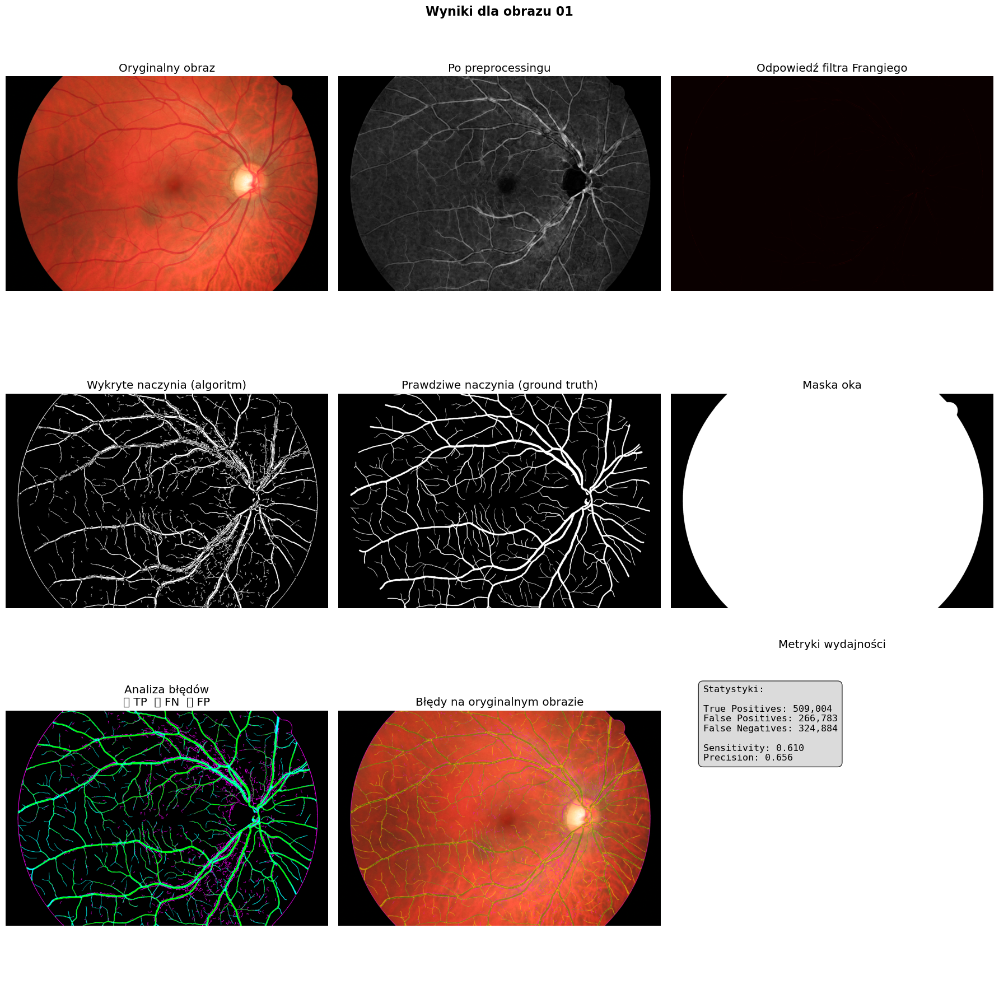


=== OCENA SKUTECZNOŚCI ALGORYTMU ===

Przetwarzanie obrazu 1/5: 01
DEBUG – kształt preprocessed_image: (2336, 3504)
Macierz pomyłek: TN=7084673, FP=266783, FN=324884, TP=509004
Accuracy: 0.9277
Sensitivity: 0.6104
Specificity: 0.9637
Balanced Accuracy: 0.7871
Geometric Mean: 0.7670

Przetwarzanie obrazu 2/5: 02
DEBUG – kształt preprocessed_image: (2336, 3504)
Macierz pomyłek: TN=7126527, FP=250395, FN=296217, TP=512205
Accuracy: 0.9332
Sensitivity: 0.6336
Specificity: 0.9661
Balanced Accuracy: 0.7998
Geometric Mean: 0.7824

Przetwarzanie obrazu 3/5: 03
DEBUG – kształt preprocessed_image: (2336, 3504)
Macierz pomyłek: TN=7046890, FP=274328, FN=382201, TP=481925
Accuracy: 0.9198
Sensitivity: 0.5577
Specificity: 0.9625
Balanced Accuracy: 0.7601
Geometric Mean: 0.7327

Przetwarzanie obrazu 4/5: 04
DEBUG – kształt preprocessed_image: (2336, 3504)
Macierz pomyłek: TN=7119684, FP=294065, FN=312259, TP=459336
Accuracy: 0.9259
Sensitivity: 0.5953
Specificity: 0.9603
Balanced Accuracy: 0.7778
G

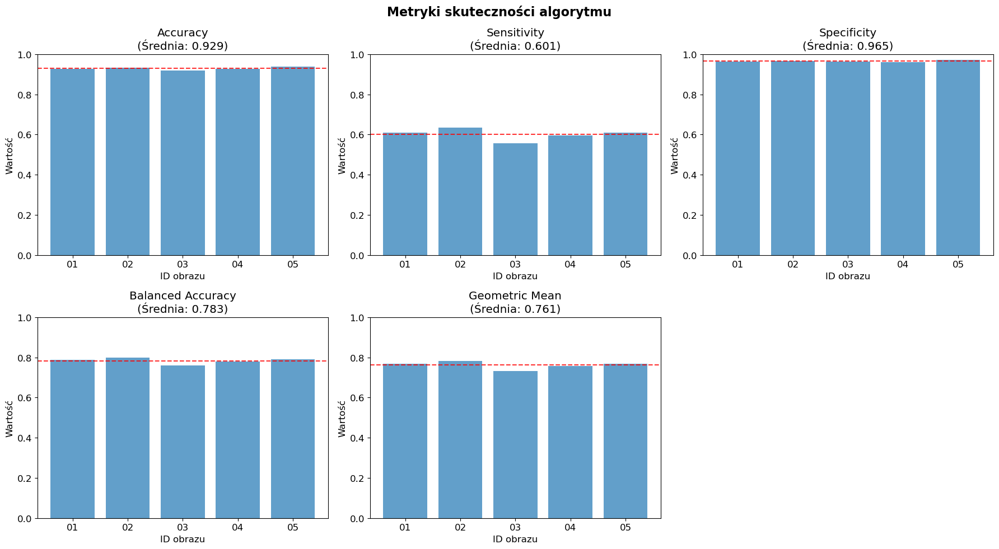

In [164]:
def check_files():
    print("Sprawdzanie dostępności plików...")
    image_files = glob.glob(os.path.join(IMAGES_DIR, "*_h.jpg"))
    mask_files = glob.glob(os.path.join(MASKS_DIR, "*_h_mask.tif"))
    manual_files = glob.glob(os.path.join(MANUAL_DIR, "*_h.tif"))
    
    print(f"Znaleziono {len(image_files)} obrazów w folderze {IMAGES_DIR}")
    print(f"Znaleziono {len(mask_files)} masek w folderze {MASKS_DIR}")
    print(f"Znaleziono {len(manual_files)} ręcznych adnotacji w folderze {MANUAL_DIR}")
    
    if len(image_files) == 0:
        print("UWAGA: Nie znaleziono plików obrazów. Sprawdź czy folder 'images' istnieje i zawiera pliki.")
    
    return sorted(image_files), sorted(mask_files), sorted(manual_files)

image_files, mask_files, manual_files = check_files()
print()

if len(image_files) > 0:
    print("Demonstracja na przykładowym obrazie")
    
    test_image_path = image_files[0]
    image_id = os.path.basename(test_image_path).split('_')[0]
    
    mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
    manual_path = os.path.join(MANUAL_DIR, f"{image_id}_h.tif")
    
    print(f"Przetwarzanie obrazu: {test_image_path}")
    print(f"Maska oka: {mask_path if os.path.exists(mask_path) else 'Brak'}")
    print(f"Ręczna adnotacja: {manual_path if os.path.exists(manual_path) else 'Brak'}")
    
    results = detector.process_single_image(
        test_image_path, 
        mask_path if os.path.exists(mask_path) else None
    )
    
    # Załaduj ground truth jeśli istnieje
    ground_truth = None
    if os.path.exists(manual_path):
        ground_truth = detector.load_mask(manual_path)
    
    # Wywołaj wizualizację z ground truth
    detector.visualize_results(
        results, 
        f"Wyniki dla obrazu {image_id}", 
        ground_truth_mask=ground_truth
    )
    
    print()
    print("=== OCENA SKUTECZNOŚCI ALGORYTMU ===")
    
    all_metrics = []
    
    test_count = min(5, len(image_files))
    
    for i in range(test_count):
        image_path = image_files[i]
        image_id = os.path.basename(image_path).split('_')[0]
        
        mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
        manual_path = os.path.join(MANUAL_DIR, f"{image_id}_h.tif")
        
        print(f"\nPrzetwarzanie obrazu {i+1}/{test_count}: {image_id}")
        
        if not os.path.exists(manual_path):
            print(f"Brak ręcznej adnotacji dla obrazu {image_id}")
            continue
        
        results = detector.process_single_image(
            image_path,
            mask_path if os.path.exists(mask_path) else None
        )
        
        manual_annotation = detector.load_mask(manual_path)
        
        # Dodaj wizualizację z analizą błędów dla każdego obrazu (opcjonalnie)
        # Odkomentuj poniższą linię jeśli chcesz zobaczyć szczegółową analizę dla każdego obrazu
        # detector.visualize_results(results, f"Szczegółowa analiza - obraz {image_id}", ground_truth_mask=manual_annotation)
        
        metrics = detector.calculate_metrics(
            results['vessel_mask'],
            manual_annotation,
            results['eye_mask']
        )
        
        metrics['image_id'] = image_id
        all_metrics.append(metrics)
        
        tn, fp, fn, tp = metrics['confusion_matrix']
        print(f"Macierz pomyłek: TN={tn}, FP={fp}, FN={fn}, TP={tp}")
        print(f"Accuracy: {metrics['accuracy']:.4f}")
        print(f"Sensitivity: {metrics['sensitivity']:.4f}")
        print(f"Specificity: {metrics['specificity']:.4f}")
        print(f"Balanced Accuracy: {metrics['balanced_accuracy']:.4f}")
        print(f"Geometric Mean: {metrics['geometric_mean']:.4f}")
        
    if all_metrics:
        print("\n" + "="*50)
        print("PODSUMOWANIE WYNIKÓW")
        print("="*50)
        
        # Obliczenie średnich metryk
        avg_accuracy = np.mean([m['accuracy'] for m in all_metrics])
        avg_sensitivity = np.mean([m['sensitivity'] for m in all_metrics])
        avg_specificity = np.mean([m['specificity'] for m in all_metrics])
        avg_balanced_accuracy = np.mean([m['balanced_accuracy'] for m in all_metrics])
        avg_geometric_mean = np.mean([m['geometric_mean'] for m in all_metrics])
        
        print(f"Liczba przetestowanych obrazów: {len(all_metrics)}")
        print(f"Średnia Accuracy: {avg_accuracy:.4f} ± {np.std([m['accuracy'] for m in all_metrics]):.4f}")
        print(f"Średnia Sensitivity: {avg_sensitivity:.4f} ± {np.std([m['sensitivity'] for m in all_metrics]):.4f}")
        print(f"Średnia Specificity: {avg_specificity:.4f} ± {np.std([m['specificity'] for m in all_metrics]):.4f}")
        print(f"Średnia Balanced Accuracy: {avg_balanced_accuracy:.4f} ± {np.std([m['balanced_accuracy'] for m in all_metrics]):.4f}")
        print(f"Średnia Geometric Mean: {avg_geometric_mean:.4f} ± {np.std([m['geometric_mean'] for m in all_metrics]):.4f}")
        
        # Wykres metryk (bez zmian)
        fig, axes = plt.subplots(2, 3, figsize=(18, 10))
        fig.suptitle('Metryki skuteczności algorytmu', fontsize=16, fontweight='bold')
        
        metrics_names = ['accuracy', 'sensitivity', 'specificity', 'balanced_accuracy', 'geometric_mean']
        metrics_labels = ['Accuracy', 'Sensitivity', 'Specificity', 'Balanced Accuracy', 'Geometric Mean']
        
        for idx, (metric_name, metric_label) in enumerate(zip(metrics_names, metrics_labels)):
            row = idx // 3
            col = idx % 3
            
            values = [m[metric_name] for m in all_metrics]
            image_ids = [m['image_id'] for m in all_metrics]
            
            axes[row, col].bar(image_ids, values, alpha=0.7)
            axes[row, col].set_title(f'{metric_label}\n(Średnia: {np.mean(values):.3f})')
            axes[row, col].set_xlabel('ID obrazu')
            axes[row, col].set_ylabel('Wartość')
            axes[row, col].set_ylim(0, 1)
            
            # Linia średniej
            axes[row, col].axhline(y=np.mean(values), color='red', linestyle='--', alpha=0.8)
    
        axes[1, 2].set_visible(False)
        
        plt.tight_layout()
        plt.show()
            
else:
    print("Demonstracja bez rzeczywistych plików obrazów:")
    print("Aby uruchomić pełną analizę, umieść pliki w odpowiednich folderach:")
    print(f"- Obrazy: {IMAGES_DIR}/01_h.jpg, 02_h.jpg, ..., 15_h.jpg")
    print(f"- Maski: {MASKS_DIR}/01_h_mask.tif, 02_h_mask.tif, ..., 15_h_mask.tif")
    print(f"- Ręczne adnotacje: {MANUAL_DIR}/01_h.tif, 02_h.tif, ..., 15_h.tif")

In [165]:
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, balanced_accuracy_score
from sklearn.model_selection import train_test_split

=== DEMONSTRACJA KLASYFIKATORA CECH ===

Podział danych: 9 obrazów do treningu, 6 do testu
Dane treningowe: 9 obrazów
Dane testowe: 6 obrazów

TESTOWANIE KLASYFIKATORA: RANDOM_FOREST
Trenowanie klasyfikatora: random_forest
Parametry: step=20, max_samples_per_image=2000

Przetwarzanie obrazu treningowego 1/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 2/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1759
Klasa 1 (naczynia): 241

Przetwarzanie obrazu treningowego 3/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetw

Przetworzono 80000/276307 wycinków
Przetworzono 90000/276307 wycinków
Przetworzono 100000/276307 wycinków
Przetworzono 110000/276307 wycinków
Przetworzono 120000/276307 wycinków
Przetworzono 130000/276307 wycinków
Przetworzono 140000/276307 wycinków
Przetworzono 150000/276307 wycinków
Przetworzono 160000/276307 wycinków
Przetworzono 170000/276307 wycinków
Przetworzono 180000/276307 wycinków
Przetworzono 190000/276307 wycinków
Przetworzono 200000/276307 wycinków
Przetworzono 210000/276307 wycinków
Przetworzono 220000/276307 wycinków
Przetworzono 230000/276307 wycinków
Przetworzono 240000/276307 wycinków
Przetworzono 250000/276307 wycinków
Przetworzono 260000/276307 wycinków
Przetworzono 270000/276307 wycinków
Accuracy: 0.8844
Sensitivity: 0.7395
Specificity: 0.8983

Test obrazu 6/6
Predykcja dla obrazu...
Predykcja dla 276414 wycinków...
Wyodrębnianie cech...
Przetworzono 0/276414 wycinków
Przetworzono 10000/276414 wycinków
Przetworzono 20000/276414 wycinków
Przetworzono 30000/276414 wy

C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

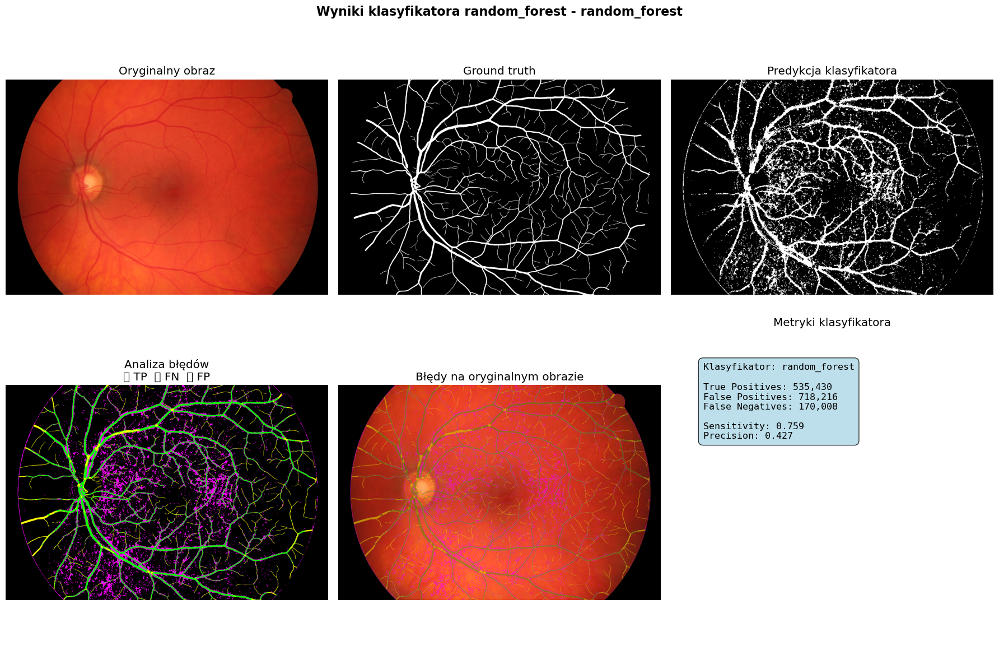


TESTOWANIE KLASYFIKATORA: SVM
Trenowanie klasyfikatora: svm
Parametry: step=20, max_samples_per_image=2000

Przetwarzanie obrazu treningowego 1/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 2/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1759
Klasa 1 (naczynia): 241

Przetwarzanie obrazu treningowego 3/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 4/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji

Przetworzono 120000/276307 wycinków
Przetworzono 130000/276307 wycinków
Przetworzono 140000/276307 wycinków
Przetworzono 150000/276307 wycinków
Przetworzono 160000/276307 wycinków
Przetworzono 170000/276307 wycinków
Przetworzono 180000/276307 wycinków
Przetworzono 190000/276307 wycinków
Przetworzono 200000/276307 wycinków
Przetworzono 210000/276307 wycinków
Przetworzono 220000/276307 wycinków
Przetworzono 230000/276307 wycinków
Przetworzono 240000/276307 wycinków
Przetworzono 250000/276307 wycinków
Przetworzono 260000/276307 wycinków
Przetworzono 270000/276307 wycinków
Accuracy: 0.8975
Sensitivity: 0.7068
Specificity: 0.9157

Test obrazu 6/6
Predykcja dla obrazu...
Predykcja dla 276414 wycinków...
Wyodrębnianie cech...
Przetworzono 0/276414 wycinków
Przetworzono 10000/276414 wycinków
Przetworzono 20000/276414 wycinków
Przetworzono 30000/276414 wycinków
Przetworzono 40000/276414 wycinków
Przetworzono 50000/276414 wycinków
Przetworzono 60000/276414 wycinków
Przetworzono 70000/276414 wyci

C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

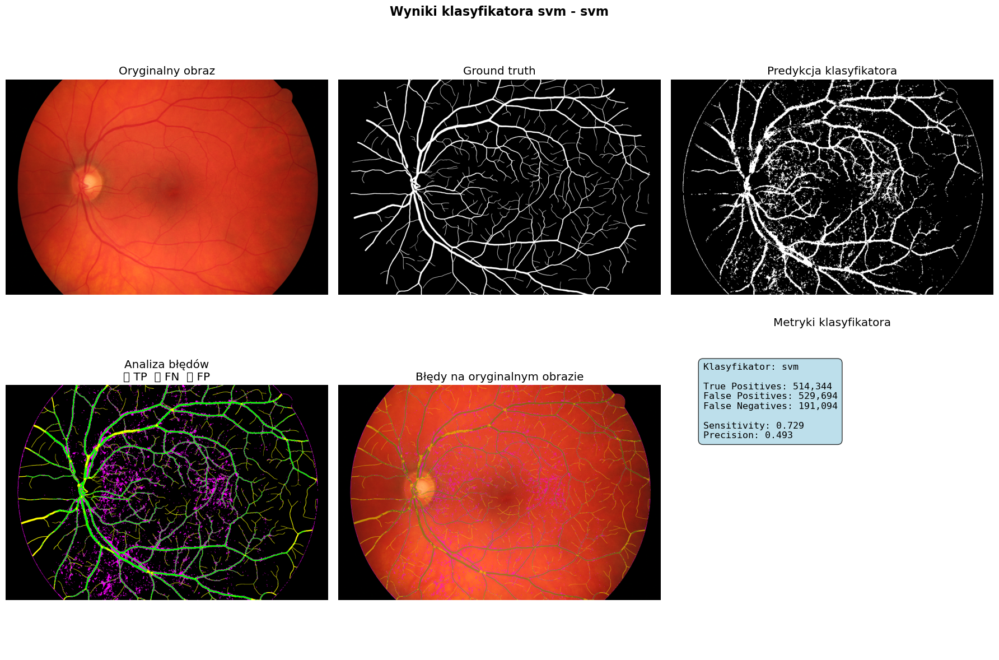


TESTOWANIE KLASYFIKATORA: KNN
Trenowanie klasyfikatora: knn
Parametry: step=20, max_samples_per_image=2000

Przetwarzanie obrazu treningowego 1/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 2/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1759
Klasa 1 (naczynia): 241

Przetwarzanie obrazu treningowego 3/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 4/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji

Przetworzono 120000/276307 wycinków
Przetworzono 130000/276307 wycinków
Przetworzono 140000/276307 wycinków
Przetworzono 150000/276307 wycinków
Przetworzono 160000/276307 wycinków
Przetworzono 170000/276307 wycinków
Przetworzono 180000/276307 wycinków
Przetworzono 190000/276307 wycinków
Przetworzono 200000/276307 wycinków
Przetworzono 210000/276307 wycinków
Przetworzono 220000/276307 wycinków
Przetworzono 230000/276307 wycinków
Przetworzono 240000/276307 wycinków
Przetworzono 250000/276307 wycinków
Przetworzono 260000/276307 wycinków
Przetworzono 270000/276307 wycinków
Accuracy: 0.8731
Sensitivity: 0.7050
Specificity: 0.8891

Test obrazu 6/6
Predykcja dla obrazu...
Predykcja dla 276414 wycinków...
Wyodrębnianie cech...
Przetworzono 0/276414 wycinków
Przetworzono 10000/276414 wycinków
Przetworzono 20000/276414 wycinków
Przetworzono 30000/276414 wycinków
Przetworzono 40000/276414 wycinków
Przetworzono 50000/276414 wycinków
Przetworzono 60000/276414 wycinków
Przetworzono 70000/276414 wyci

C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

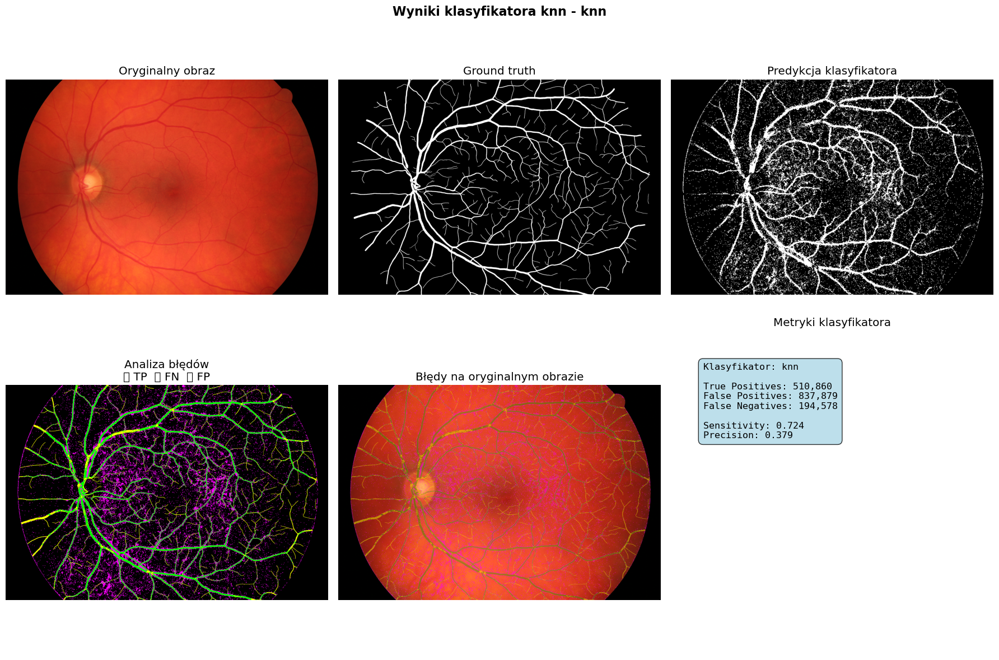


TESTOWANIE KLASYFIKATORA: DECISION_TREE
Trenowanie klasyfikatora: decision_tree
Parametry: step=20, max_samples_per_image=2000

Przetwarzanie obrazu treningowego 1/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 2/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1759
Klasa 1 (naczynia): 241

Przetwarzanie obrazu treningowego 3/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 2000 możliwych pozycji
Wyodrębniono 2000 wycinków
Klasa 0 (tło): 1755
Klasa 1 (naczynia): 245

Przetwarzanie obrazu treningowego 4/9
Wyodrębnianie wycinków 5x5 z krokiem 20, max 2000 próbek
Obszar: (2,2) do (2334,3502)
Losowo wybrano 2000 z 20

Przetworzono 120000/276307 wycinków
Przetworzono 130000/276307 wycinków
Przetworzono 140000/276307 wycinków
Przetworzono 150000/276307 wycinków
Przetworzono 160000/276307 wycinków
Przetworzono 170000/276307 wycinków
Przetworzono 180000/276307 wycinków
Przetworzono 190000/276307 wycinków
Przetworzono 200000/276307 wycinków
Przetworzono 210000/276307 wycinków
Przetworzono 220000/276307 wycinków
Przetworzono 230000/276307 wycinków
Przetworzono 240000/276307 wycinków
Przetworzono 250000/276307 wycinków
Przetworzono 260000/276307 wycinków
Przetworzono 270000/276307 wycinków
Accuracy: 0.8598
Sensitivity: 0.6986
Specificity: 0.8752

Test obrazu 6/6
Predykcja dla obrazu...
Predykcja dla 276414 wycinków...
Wyodrębnianie cech...
Przetworzono 0/276414 wycinków
Przetworzono 10000/276414 wycinków
Przetworzono 20000/276414 wycinków
Przetworzono 30000/276414 wycinków
Przetworzono 40000/276414 wycinków
Przetworzono 50000/276414 wycinków
Przetworzono 60000/276414 wycinków
Przetworzono 70000/276414 wyci

C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\2287564528.py:495: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

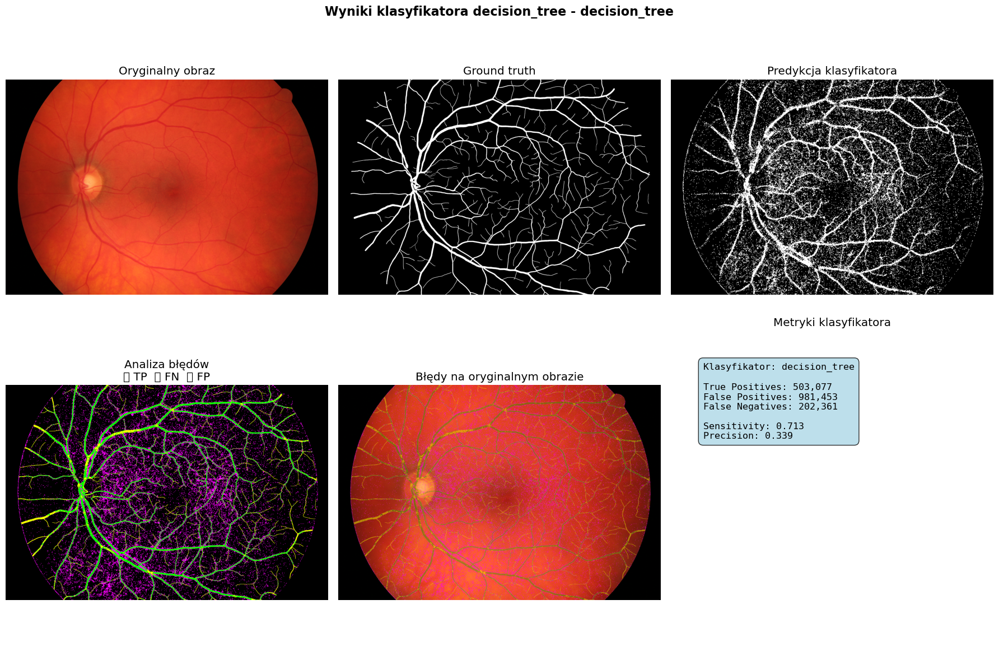


PORÓWNANIE KLASYFIKATORÓW
Klasyfikator    Accuracy   Sensitivity  Specificity  Balanced Acc
----------------------------------------------------------------------
random_forest   0.8860     0.7555       0.8983       0.8269      
svm             0.9021     0.7244       0.9190       0.8217      
knn             0.8710     0.7187       0.8854       0.8020      
decision_tree   0.8544     0.7109       0.8680       0.7895      


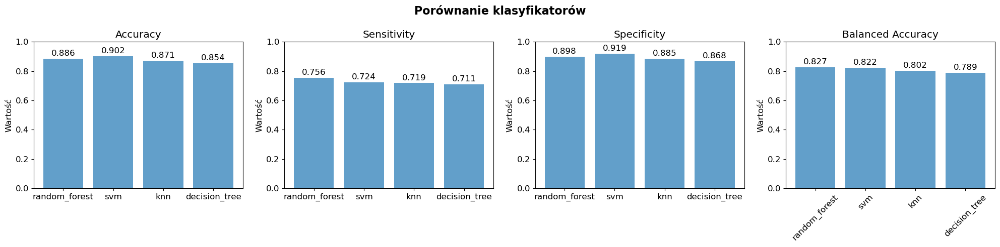

In [171]:
# Dodatkowe importy dla nowej funkcjonalności
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.utils import resample
from scipy import ndimage
import cv2

# Klasa do ekstrakcji cech z wycinków obrazu
class FeatureExtractor:
    def __init__(self, patch_size=5):
        self.patch_size = patch_size
        
    def extract_color_variance(self, patch):
        """Oblicza wariancję kolorów w wycinku"""
        if len(patch.shape) == 3:
            # Dla obrazu kolorowego - wariancja każdego kanału
            variances = [np.var(patch[:,:,i]) for i in range(patch.shape[2])]
            return variances
        else:
            # Dla obrazu w skali szarości
            return [np.var(patch)]
    
    def extract_central_moments(self, patch):
        """Oblicza momenty centralne do 3 rzędu"""
        if len(patch.shape) == 3:
            patch = cv2.cvtColor(patch, cv2.COLOR_RGB2GRAY)
        
        # Obliczenie momentów geometrycznych używając OpenCV
        moments_cv = cv2.moments(patch)
        
        # Wyodrębnienie kluczowych momentów
        central_moments = []
        
        # Momenty surowe (m_ij)
        central_moments.append(moments_cv['m00'])  # obszar
        central_moments.append(moments_cv['m10'])  # moment pierwszego rzędu x
        central_moments.append(moments_cv['m01'])  # moment pierwszego rzędu y
        central_moments.append(moments_cv['m20'])  # moment drugiego rzędu x^2
        central_moments.append(moments_cv['m11'])  # moment drugiego rzędu xy
        central_moments.append(moments_cv['m02'])  # moment drugiego rzędu y^2
        central_moments.append(moments_cv['m30'])  # moment trzeciego rzędu x^3
        central_moments.append(moments_cv['m21'])  # moment trzeciego rzędu x^2*y
        central_moments.append(moments_cv['m12'])  # moment trzeciego rzędu x*y^2
        central_moments.append(moments_cv['m03'])  # moment trzeciego rzędu y^3
        
        # Momenty centralne (mu_ij)
        central_moments.append(moments_cv['mu20'])  # moment centralny drugiego rzędu
        central_moments.append(moments_cv['mu11'])  # moment centralny drugiego rzędu
        central_moments.append(moments_cv['mu02'])  # moment centralny drugiego rzędu
        central_moments.append(moments_cv['mu30'])  # moment centralny trzeciego rzędu
        central_moments.append(moments_cv['mu21'])  # moment centralny trzeciego rzędu
        central_moments.append(moments_cv['mu12'])  # moment centralny trzeciego rzędu
        central_moments.append(moments_cv['mu03'])  # moment centralny trzeciego rzędu
        
        # Momenty znormalizowane (nu_ij)
        central_moments.append(moments_cv['nu20'])  # moment znormalizowany
        central_moments.append(moments_cv['nu11'])  # moment znormalizowany
        central_moments.append(moments_cv['nu02'])  # moment znormalizowany
        central_moments.append(moments_cv['nu30'])  # moment znormalizowany
        central_moments.append(moments_cv['nu21'])  # moment znormalizowany
        central_moments.append(moments_cv['nu12'])  # moment znormalizowany
        central_moments.append(moments_cv['nu03'])  # moment znormalizowany
        
        return central_moments[:15]  # Pierwsze 15 momentów
    
    def extract_hu_moments(self, patch):
        """Oblicza niezmienniki Hu"""
        if len(patch.shape) == 3:
            patch = cv2.cvtColor(patch, cv2.COLOR_RGB2GRAY)
        
        # Momenty geometryczne
        moments = cv2.moments(patch)
        
        # Niezmienniki Hu
        hu_moments = cv2.HuMoments(moments).flatten()
        
        # Logarytmiczna transformacja (unikamy log(0))
        hu_moments = -np.sign(hu_moments) * np.log10(np.abs(hu_moments) + 1e-10)
        
        return hu_moments.tolist()
    
    def extract_texture_features(self, patch):
        """Dodatkowe cechy tekstury"""
        if len(patch.shape) == 3:
            patch = cv2.cvtColor(patch, cv2.COLOR_RGB2GRAY)
        
        features = []
        
        # Średnia i odchylenie standardowe
        features.append(np.mean(patch))
        features.append(np.std(patch))
        
        # Entropia
        hist, _ = np.histogram(patch, bins=256, range=(0, 255))
        hist = hist / np.sum(hist)  # normalizacja
        entropy = -np.sum(hist * np.log2(hist + 1e-10))
        features.append(entropy)
        
        # Gradientowe cechy
        gx = cv2.Sobel(patch, cv2.CV_64F, 1, 0, ksize=3)
        gy = cv2.Sobel(patch, cv2.CV_64F, 0, 1, ksize=3)
        grad_magnitude = np.sqrt(gx**2 + gy**2)
        
        features.append(np.mean(grad_magnitude))
        features.append(np.std(grad_magnitude))
        
        return features
    
    def extract_all_features(self, patch):
        """Wyodrębnia wszystkie cechy z wycinku"""
        features = []
        
        # Wariancja kolorów
        features.extend(self.extract_color_variance(patch))
        
        # Momenty centralne
        features.extend(self.extract_central_moments(patch))
        
        # Niezmienniki Hu
        features.extend(self.extract_hu_moments(patch))
        
        # Cechy tekstury
        features.extend(self.extract_texture_features(patch))
        
        return features


# Klasa klasyfikatora naczyń opartego na cechach
class VesselClassifier:
    def __init__(self, patch_size=5, classifier_type='random_forest'):
        self.patch_size = patch_size
        self.classifier_type = classifier_type
        self.feature_extractor = FeatureExtractor(patch_size)
        self.scaler = StandardScaler()
        self.classifier = None
        self.is_trained = False
        
        # Inicjalizacja klasyfikatora
        self._init_classifier()
    
    def _init_classifier(self):
        """Inicjalizuje wybrany klasyfikator"""
        if self.classifier_type == 'random_forest':
            self.classifier = RandomForestClassifier(
                n_estimators=100, 
                random_state=42, 
                max_depth=10,
                min_samples_split=5
            )
        elif self.classifier_type == 'svm':
            self.classifier = SVC(
                kernel='rbf', 
                C=1.0, 
                gamma='scale', 
                random_state=42
            )
        elif self.classifier_type == 'knn':
            self.classifier = KNeighborsClassifier(
                n_neighbors=5, 
                weights='distance'
            )
        elif self.classifier_type == 'decision_tree':
            self.classifier = DecisionTreeClassifier(
                random_state=42, 
                max_depth=10,
                min_samples_split=5
            )
        else:
            raise ValueError(f"Nieznany typ klasyfikatora: {self.classifier_type}")
    
    def extract_patches_and_labels(self, image, ground_truth_mask, eye_mask=None, step=10, max_samples=5000):
        """
        Wyodrębnia wycinki z obrazu i odpowiadające im etykiety
        step - krok przesunięcia (dla oszczędności pamięci)
        max_samples - maksymalna liczba próbek z jednego obrazu
        """
        patches = []
        labels = []
        
        half_patch = self.patch_size // 2
        
        # Granice dla wycinków
        start_y = half_patch
        end_y = image.shape[0] - half_patch
        start_x = half_patch  
        end_x = image.shape[1] - half_patch
        
        print(f"Wyodrębnianie wycinków {self.patch_size}x{self.patch_size} z krokiem {step}, max {max_samples} próbek")
        print(f"Obszar: ({start_y},{start_x}) do ({end_y},{end_x})")
        
        # Generowanie wszystkich możliwych pozycji
        positions = []
        for y in range(start_y, end_y, step):
            for x in range(start_x, end_x, step):
                if eye_mask is not None and eye_mask[y, x] == 0:
                    continue
                positions.append((y, x))
        
        # Losowe próbkowanie jeśli mamy za dużo pozycji
        if len(positions) > max_samples:
            np.random.seed(42)  # dla powtarzalności
            selected_indices = np.random.choice(len(positions), max_samples, replace=False)
            positions = [positions[i] for i in selected_indices]
            print(f"Losowo wybrano {max_samples} z {len(positions)} możliwych pozycji")
        
        for y, x in positions:
            # Wyodrębnij wycinek
            patch = image[y-half_patch:y+half_patch+1, x-half_patch:x+half_patch+1]
            
            # Sprawdź rozmiar wycinku
            if patch.shape[0] != self.patch_size or patch.shape[1] != self.patch_size:
                continue
            
            # Etykieta z maski eksperckiej (środkowy piksel)
            label = 1 if ground_truth_mask[y, x] > 0 else 0
            
            patches.append(patch)
            labels.append(label)
        
        print(f"Wyodrębniono {len(patches)} wycinków")
        print(f"Klasa 0 (tło): {labels.count(0)}")
        print(f"Klasa 1 (naczynia): {labels.count(1)}")
        
        return patches, labels
    
    def extract_features_from_patches(self, patches):
        """Wyodrębnia cechy ze wszystkich wycinków"""
        print("Wyodrębnianie cech...")
        features = []
        
        for i, patch in enumerate(patches):
            if i % 10000 == 0:
                print(f"Przetworzono {i}/{len(patches)} wycinków")
            
            patch_features = self.feature_extractor.extract_all_features(patch)
            features.append(patch_features)
        
        return np.array(features)
    
    def balance_dataset(self, X, y, method='undersample'):
        """Równoważy zbiór danych"""
        unique, counts = np.unique(y, return_counts=True)
        print(f"Przed równoważeniem: {dict(zip(unique, counts))}")
        
        if method == 'undersample':
            # Undersampling - bierz tyle próbek klasy większościowej ile jest w mniejszościowej
            min_class_size = min(counts)
            
            # Oddziel klasy
            X_majority = X[y == 0]
            X_minority = X[y == 1]
            y_majority = y[y == 0]
            y_minority = y[y == 1]
            
            # Losowy wybór próbek z klasy większościowej
            X_majority_resampled, y_majority_resampled = resample(
                X_majority, y_majority,
                n_samples=min_class_size,
                random_state=42
            )
            
            # Połącz zbiory
            X_balanced = np.vstack([X_majority_resampled, X_minority])
            y_balanced = np.hstack([y_majority_resampled, y_minority])
            
        else:
            X_balanced, y_balanced = X, y
        
        unique, counts = np.unique(y_balanced, return_counts=True)
        print(f"Po równoważeniu: {dict(zip(unique, counts))}")
        
        return X_balanced, y_balanced
    
    def train(self, training_images, training_masks, eye_masks=None, 
              validation_split=0.2, balance_data=True, step=15, max_samples_per_image=3000):
        """Trenuje klasyfikator"""
        print(f"Trenowanie klasyfikatora: {self.classifier_type}")
        print(f"Parametry: step={step}, max_samples_per_image={max_samples_per_image}")
        
        all_patches = []
        all_labels = []
        
        # Wyodrębnianie danych z wszystkich obrazów treningowych
        for i, (image, mask) in enumerate(zip(training_images, training_masks)):
            print(f"\nPrzetwarzanie obrazu treningowego {i+1}/{len(training_images)}")
            
            eye_mask = eye_masks[i] if eye_masks is not None else None
            patches, labels = self.extract_patches_and_labels(
                image, mask, eye_mask, step, max_samples_per_image
            )
            
            all_patches.extend(patches)
            all_labels.extend(labels)
        
        print(f"\nŁącznie wyodrębniono {len(all_patches)} wycinków z {len(training_images)} obrazów")
        
        # Wyodrębnianie cech
        X = self.extract_features_from_patches(all_patches)
        y = np.array(all_labels)
        
        print(f"Macierz cech: {X.shape}")
        
        # Równoważenie zbioru danych
        if balance_data:
            X, y = self.balance_dataset(X, y)
        
        # Podział na treningowy i walidacyjny
        X_train, X_val, y_train, y_val = train_test_split(
            X, y, test_size=validation_split, random_state=42, stratify=y
        )
        
        # Normalizacja cech
        print("Normalizacja cech...")
        X_train_scaled = self.scaler.fit_transform(X_train)
        X_val_scaled = self.scaler.transform(X_val)
        
        # Trenowanie
        print("Trenowanie klasyfikatora...")
        self.classifier.fit(X_train_scaled, y_train)
        
        # Ocena na zbiorze walidacyjnym
        y_val_pred = self.classifier.predict(X_val_scaled)
        val_accuracy = np.mean(y_val_pred == y_val)
        
        print(f"\nWyniki na zbiorze walidacyjnym:")
        print(f"Dokładność: {val_accuracy:.4f}")
        print("\nRaport klasyfikacji:")
        print(classification_report(y_val, y_val_pred))
        
        self.is_trained = True
        
        return {
            'validation_accuracy': val_accuracy,
            'validation_report': classification_report(y_val, y_val_pred, output_dict=True)
        }
    
    def predict_image(self, image, eye_mask=None, step=5):
        """Predykcja dla całego obrazu"""
        if not self.is_trained:
            raise ValueError("Klasyfikator nie został wytrenowany!")
        
        print("Predykcja dla obrazu...")
        
        # Inicjalizacja maski wynikowej
        result_mask = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)
        
        half_patch = self.patch_size // 2
        patches = []
        coordinates = []
        
        # Wyodrębnianie wycinków do predykcji
        for y in range(half_patch, image.shape[0] - half_patch, step):
            for x in range(half_patch, image.shape[1] - half_patch, step):
                if eye_mask is not None and eye_mask[y, x] == 0:
                    continue
                
                patch = image[y-half_patch:y+half_patch+1, x-half_patch:x+half_patch+1]
                
                if patch.shape[0] == self.patch_size and patch.shape[1] == self.patch_size:
                    patches.append(patch)
                    coordinates.append((y, x))
        
        if len(patches) == 0:
            print("Brak wycinków do predykcji!")
            return result_mask
        
        print(f"Predykcja dla {len(patches)} wycinków...")
        
        # Wyodrębnianie cech i predykcja
        X = self.extract_features_from_patches(patches)
        X_scaled = self.scaler.transform(X)
        predictions = self.classifier.predict(X_scaled)
        
        # Wypełnianie maski wynikowej
        for (y, x), pred in zip(coordinates, predictions):
            if pred == 1:
                # Wypełnij obszar wokół środkowego piksela
                y_start = max(0, y - step//2)
                y_end = min(image.shape[0], y + step//2 + 1)
                x_start = max(0, x - step//2) 
                x_end = min(image.shape[1], x + step//2 + 1)
                
                result_mask[y_start:y_end, x_start:x_end] = 255
        
        return result_mask
    
    def evaluate_on_test_set(self, test_images, test_masks, eye_masks=None):
        """Ocena klasyfikatora na zbiorze testowym"""
        print("Ocena na zbiorze testowym...")
        
        all_metrics = []
        
        for i, (test_image, test_mask) in enumerate(zip(test_images, test_masks)):
            print(f"\nTest obrazu {i+1}/{len(test_images)}")
            
            eye_mask = eye_masks[i] if eye_masks is not None else None
            predicted_mask = self.predict_image(test_image, eye_mask)
            
            # Oblicz metryki używając istniejącej metody z BloodVesselDetector
            # (zakładamy, że mamy dostęp do instancji detector)
            metrics = detector.calculate_metrics(predicted_mask, test_mask, eye_mask)
            all_metrics.append(metrics)
            
            print(f"Accuracy: {metrics['accuracy']:.4f}")
            print(f"Sensitivity: {metrics['sensitivity']:.4f}")
            print(f"Specificity: {metrics['specificity']:.4f}")
        
        # Średnie metryki
        avg_metrics = {
            'accuracy': np.mean([m['accuracy'] for m in all_metrics]),
            'sensitivity': np.mean([m['sensitivity'] for m in all_metrics]),
            'specificity': np.mean([m['specificity'] for m in all_metrics]),
            'balanced_accuracy': np.mean([m['balanced_accuracy'] for m in all_metrics]),
            'geometric_mean': np.mean([m['geometric_mean'] for m in all_metrics])
        }
        
        print(f"\n=== ŚREDNIE WYNIKI KLASYFIKATORA ===")
        for metric, value in avg_metrics.items():
            print(f"{metric}: {value:.4f}")
        
        return all_metrics, avg_metrics
    
    def visualize_classifier_results(self, image, ground_truth, predicted_mask, eye_mask=None, title="Wyniki klasyfikatora"):
        """Wizualizacja wyników klasyfikatora w stylu oryginalnej metody"""
        fig, axes = plt.subplots(2, 3, figsize=(18, 12))
        fig.suptitle(f"{title} - {self.classifier_type}", fontsize=16, fontweight='bold')
        
        # Rząd 1
        axes[0,0].imshow(image)
        axes[0,0].set_title('Oryginalny obraz')
        axes[0,0].axis('off')
        
        axes[0,1].imshow(ground_truth, cmap='gray')
        axes[0,1].set_title('Ground truth')
        axes[0,1].axis('off')
        
        axes[0,2].imshow(predicted_mask, cmap='gray')
        axes[0,2].set_title('Predykcja klasyfikatora')
        axes[0,2].axis('off')
        
        # Rząd 2 - Analiza błędów
        pred_binary = (predicted_mask > 0).astype(np.uint8)
        gt_binary = (ground_truth > 0).astype(np.uint8)
        
        if eye_mask is not None:
            eye_binary = (eye_mask > 0).astype(np.uint8)
            pred_binary = pred_binary * eye_binary
            gt_binary = gt_binary * eye_binary
        
        tp_mask = (pred_binary == 1) & (gt_binary == 1)
        fp_mask = (pred_binary == 1) & (gt_binary == 0)
        fn_mask = (pred_binary == 0) & (gt_binary == 1)
        
        # Mapa błędów
        error_analysis = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)
        error_analysis[tp_mask] = [0, 255, 0]  # TP = zielony
        error_analysis[fp_mask] = [255, 0, 255]  # FP = magenta
        error_analysis[fn_mask] = [255, 255, 0]  # FN = żółty
        
        axes[1,0].imshow(error_analysis)
        axes[1,0].set_title('Analiza błędów\n🟢 TP  🟡 FN  🟣 FP')
        axes[1,0].axis('off')
        
        # Overlay
        overlay = image.copy()
        overlay[tp_mask] = overlay[tp_mask] * 0.7 + np.array([0, 255, 0]) * 0.3
        overlay[fp_mask] = overlay[fp_mask] * 0.5 + np.array([255, 0, 255]) * 0.5
        overlay[fn_mask] = overlay[fn_mask] * 0.5 + np.array([255, 255, 0]) * 0.5
        
        axes[1,1].imshow(overlay)
        axes[1,1].set_title('Błędy na oryginalnym obrazie')
        axes[1,1].axis('off')
        
        # Statystyki
        tp_count = np.sum(tp_mask)
        fp_count = np.sum(fp_mask)
        fn_count = np.sum(fn_mask)
        
        sensitivity = tp_count / (tp_count + fn_count) if (tp_count + fn_count) > 0 else 0
        precision = tp_count / (tp_count + fp_count) if (tp_count + fp_count) > 0 else 0
        
        stats_text = f"Klasyfikator: {self.classifier_type}\n\nTrue Positives: {tp_count:,}\nFalse Positives: {fp_count:,}\nFalse Negatives: {fn_count:,}\n\nSensitivity: {sensitivity:.3f}\nPrecision: {precision:.3f}"
        
        axes[1,2].text(0.1, 0.9, stats_text, transform=axes[1,2].transAxes,
                      fontsize=12, verticalalignment='top', fontfamily='monospace',
                      bbox=dict(boxstyle="round,pad=0.5", facecolor="lightblue", alpha=0.8))
        axes[1,2].set_title('Metryki klasyfikatora')
        axes[1,2].axis('off')
        
        plt.tight_layout()
        plt.show()


# Funkcja demonstracyjna dla nowej funkcjonalności
def demonstrate_classifier():
    """Demonstracja działania klasyfikatora cech"""
    print("=== DEMONSTRACJA KLASYFIKATORA CECH ===\n")
    
    if len(image_files) < 2:
        print("Potrzeba co najmniej 2 obrazów do demonstracji klasyfikatora")
        return
    
    # Przygotowanie danych treningowych i testowych
    train_images = []
    train_masks = []
    train_eye_masks = []
    
    test_images = []
    test_masks = []
    test_eye_masks = []
    
    # Podział obrazów: pierwsze 60% do treningu, reszta do testu
    split_point = max(1, int(len(image_files) * 0.6))
    
    print(f"Podział danych: {split_point} obrazów do treningu, {len(image_files) - split_point} do testu")
    
    # Wczytanie danych treningowych
    for i in range(split_point):
        image_path = image_files[i]
        image_id = os.path.basename(image_path).split('_')[0]
        
        mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
        manual_path = os.path.join(MANUAL_DIR, f"{image_id}_h.tif")
        
        if not os.path.exists(manual_path):
            continue
            
        image = detector.load_image(image_path)
        preprocessed = detector.preprocess_image(image, 
                                               detector.load_mask(mask_path) if os.path.exists(mask_path) else None)
        manual_mask = detector.load_mask(manual_path)
        eye_mask = detector.load_mask(mask_path) if os.path.exists(mask_path) else None
        
        train_images.append(preprocessed)
        train_masks.append(manual_mask)
        train_eye_masks.append(eye_mask)
    
    # Wczytanie danych testowych
    for i in range(split_point, len(image_files)):
        image_path = image_files[i]
        image_id = os.path.basename(image_path).split('_')[0]
        
        mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
        manual_path = os.path.join(MANUAL_DIR, f"{image_id}_h.tif")
        
        if not os.path.exists(manual_path):
            continue
            
        image = detector.load_image(image_path)
        preprocessed = detector.preprocess_image(image,
                                               detector.load_mask(mask_path) if os.path.exists(mask_path) else None)
        manual_mask = detector.load_mask(manual_path)
        eye_mask = detector.load_mask(mask_path) if os.path.exists(mask_path) else None
        
        test_images.append(preprocessed)
        test_masks.append(manual_mask)
        test_eye_masks.append(eye_mask)
    
    if len(train_images) == 0 or len(test_images) == 0:
        print("Brak wystarczających danych do demonstracji")
        return
    
    print(f"Dane treningowe: {len(train_images)} obrazów")
    print(f"Dane testowe: {len(test_images)} obrazów")
    
    # Test różnych klasyfikatorów
    classifiers_to_test = ['random_forest', 'svm', 'knn', 'decision_tree']
    results = {}
    
    for clf_type in classifiers_to_test:
        print(f"\n{'='*50}")
        print(f"TESTOWANIE KLASYFIKATORA: {clf_type.upper()}")
        print(f"{'='*50}")
        
        # Inicjalizacja klasyfikatora
        classifier = VesselClassifier(
            patch_size=5, 
            classifier_type=clf_type
        )
        
        # Trenowanie
        train_results = classifier.train(
            train_images, 
            train_masks, 
            train_eye_masks,
            step=20,  # Duży krok dla szybkości
            max_samples_per_image=2000  # Maksymalnie 2000 próbek na obraz
        )
        
        # Test na zbiorze testowym
        test_metrics, avg_metrics = classifier.evaluate_on_test_set(
            test_images, 
            test_masks, 
            test_eye_masks
        )
        
        results[clf_type] = avg_metrics
        
        # Wizualizacja dla pierwszego obrazu testowego
        if len(test_images) > 0:
            predicted_mask = classifier.predict_image(test_images[0], test_eye_masks[0])
            
            # Wczytaj oryginalny obraz do wizualizacji
            test_image_path = image_files[split_point]
            original_image = detector.load_image(test_image_path)
            
            classifier.visualize_classifier_results(
                original_image,
                test_masks[0],
                predicted_mask,
                test_eye_masks[0],
                f"Wyniki klasyfikatora {clf_type}"
            )
    
    # Porównanie wszystkich klasyfikatorów
    print(f"\n{'='*60}")
    print("PORÓWNANIE KLASYFIKATORÓW")
    print(f"{'='*60}")
    
    comparison_data = []
    for clf_name, metrics in results.items():
        comparison_data.append([
            clf_name,
            f"{metrics['accuracy']:.4f}",
            f"{metrics['sensitivity']:.4f}",
            f"{metrics['specificity']:.4f}",
            f"{metrics['balanced_accuracy']:.4f}"
        ])
    
    # Tabela porównawcza
    headers = ['Klasyfikator', 'Accuracy', 'Sensitivity', 'Specificity', 'Balanced Acc']
    print(f"{'Klasyfikator':<15} {'Accuracy':<10} {'Sensitivity':<12} {'Specificity':<12} {'Balanced Acc':<12}")
    print("-" * 70)
    for row in comparison_data:
        print(f"{row[0]:<15} {row[1]:<10} {row[2]:<12} {row[3]:<12} {row[4]:<12}")
    
    # Wykres porównawczy
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))
    fig.suptitle('Porównanie klasyfikatorów', fontsize=16, fontweight='bold')
    
    metrics_to_plot = ['accuracy', 'sensitivity', 'specificity', 'balanced_accuracy']
    metric_labels = ['Accuracy', 'Sensitivity', 'Specificity', 'Balanced Accuracy']
    
    for i, (metric, label) in enumerate(zip(metrics_to_plot, metric_labels)):
        values = [results[clf][metric] for clf in classifiers_to_test]
        bars = axes[i].bar(classifiers_to_test, values, alpha=0.7)
        axes[i].set_title(label)
        axes[i].set_ylabel('Wartość')
        axes[i].set_ylim(0, 1)
        
        # Dodaj wartości na słupkach
        for bar, value in zip(bars, values):
            axes[i].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.01,
                        f'{value:.3f}', ha='center', va='bottom')
    
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Uruchomienie demonstracji
if __name__ == "__main__":
    demonstrate_classifier()

=== ANALIZA PRĘDKOŚCI PREDYKCJI ===
Test szybkości predykcji na obrazie 01
Rozmiar obrazu: (2336, 3504)
--------------------------------------------------
Pełna analiza (każdy piksel)....... 6,904,661 pozycji (  1.2x przyspieszenie)
Co 2-gi piksel..................... 1,726,146 pozycji (  4.7x przyspieszenie)
Co 3-ci piksel.....................  767,682 pozycji ( 10.6x przyspieszenie)
Co 5-ty piksel.....................  276,455 pozycji ( 29.5x przyspieszenie)
Co 3-ci piksel + ROI...............  230,304 pozycji ( 35.4x przyspieszenie)
Co 5-ty piksel + ROI...............   82,936 pozycji ( 98.4x przyspieszenie)


=== PEŁNY EKSPERYMENT KLASYFIKATORA ===
Sprawdzanie dostępności plików...
Znaleziono 15 obrazów w folderze images
Znaleziono 15 masek w folderze mask
Znaleziono 15 ręcznych adnotacji w folderze manual1
Znaleziono 15 obrazów z maskami prawdy
Zbiór treningowy: 12 obrazów
Zbiór testowy: 3 obrazów
=== TRENOWANIE KLASYFIKATORA ===

Przetwarzanie obrazu treningowego 1/12
Wyciąganie 

C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

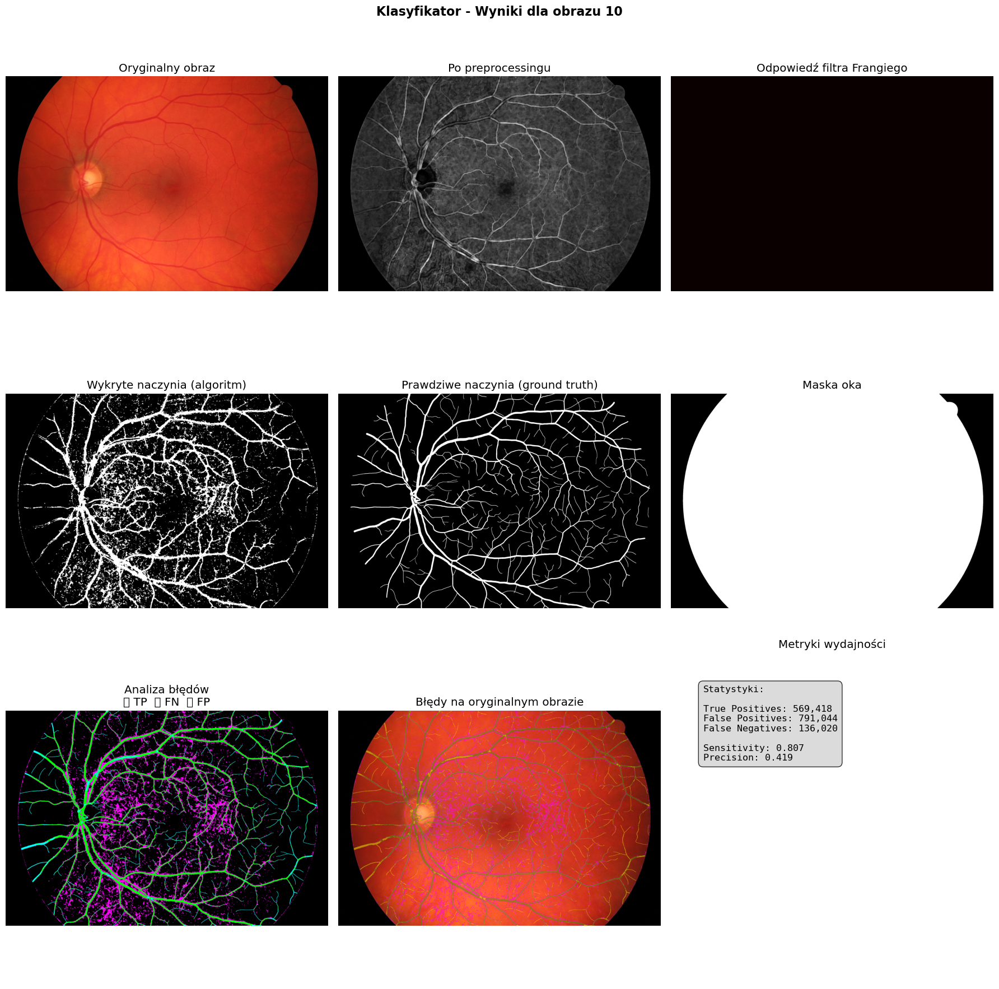

Obraz 10:
  Accuracy: 0.8867
  Sensitivity: 0.8072
  Specificity: 0.8942
  Balanced Accuracy: 0.8507

Testowanie na obrazie 2/3
Tworzenie Region of Interest...
ROI pokrywa 99.1% obrazu
Przewidywanie - sprawdzamy 760,734 pozycji
Przyspieszenie: 10.7x mniej obliczeń niż pełna analiza
Postęp: 0.0% (0/760,734)
Postęp: 6.6% (50,000/760,734)
Postęp: 13.1% (100,000/760,734)
Postęp: 19.7% (150,000/760,734)
Postęp: 26.3% (200,000/760,734)
Postęp: 32.9% (250,000/760,734)
Postęp: 39.4% (300,000/760,734)
Postęp: 46.0% (350,000/760,734)
Postęp: 52.6% (400,000/760,734)
Postęp: 59.2% (450,000/760,734)
Postęp: 65.7% (500,000/760,734)
Postęp: 72.3% (550,000/760,734)
Postęp: 78.9% (600,000/760,734)
Postęp: 85.4% (650,000/760,734)
Postęp: 92.0% (700,000/760,734)
Postęp: 98.6% (750,000/760,734)


C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

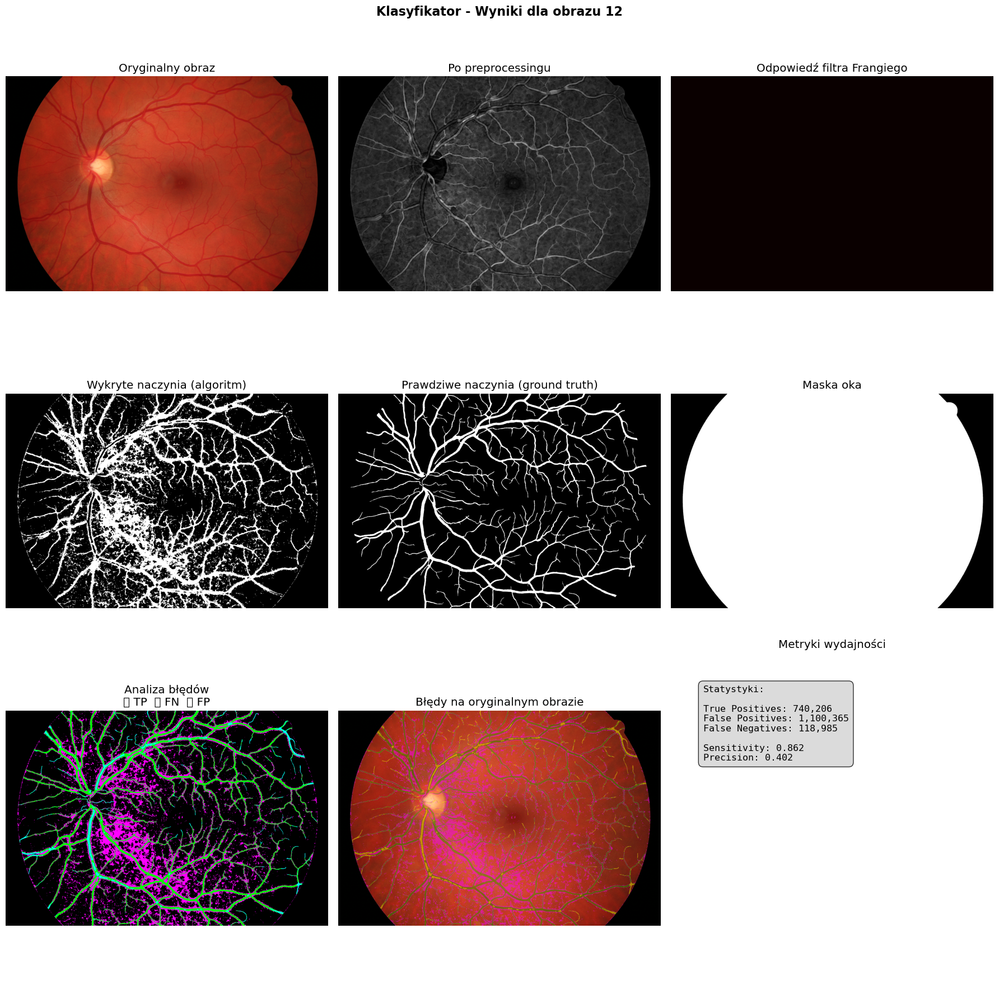

Obraz 12:
  Accuracy: 0.8510
  Sensitivity: 0.8615
  Specificity: 0.8498
  Balanced Accuracy: 0.8557

Testowanie na obrazie 3/3
Tworzenie Region of Interest...
ROI pokrywa 98.9% obrazu
Przewidywanie - sprawdzamy 759,349 pozycji
Przyspieszenie: 10.7x mniej obliczeń niż pełna analiza
Postęp: 0.0% (0/759,349)
Postęp: 6.6% (50,000/759,349)
Postęp: 13.2% (100,000/759,349)
Postęp: 19.8% (150,000/759,349)
Postęp: 26.3% (200,000/759,349)
Postęp: 32.9% (250,000/759,349)
Postęp: 39.5% (300,000/759,349)
Postęp: 46.1% (350,000/759,349)
Postęp: 52.7% (400,000/759,349)
Postęp: 59.3% (450,000/759,349)
Postęp: 65.8% (500,000/759,349)
Postęp: 72.4% (550,000/759,349)
Postęp: 79.0% (600,000/759,349)
Postęp: 85.6% (650,000/759,349)
Postęp: 92.2% (700,000/759,349)
Postęp: 98.8% (750,000/759,349)


C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

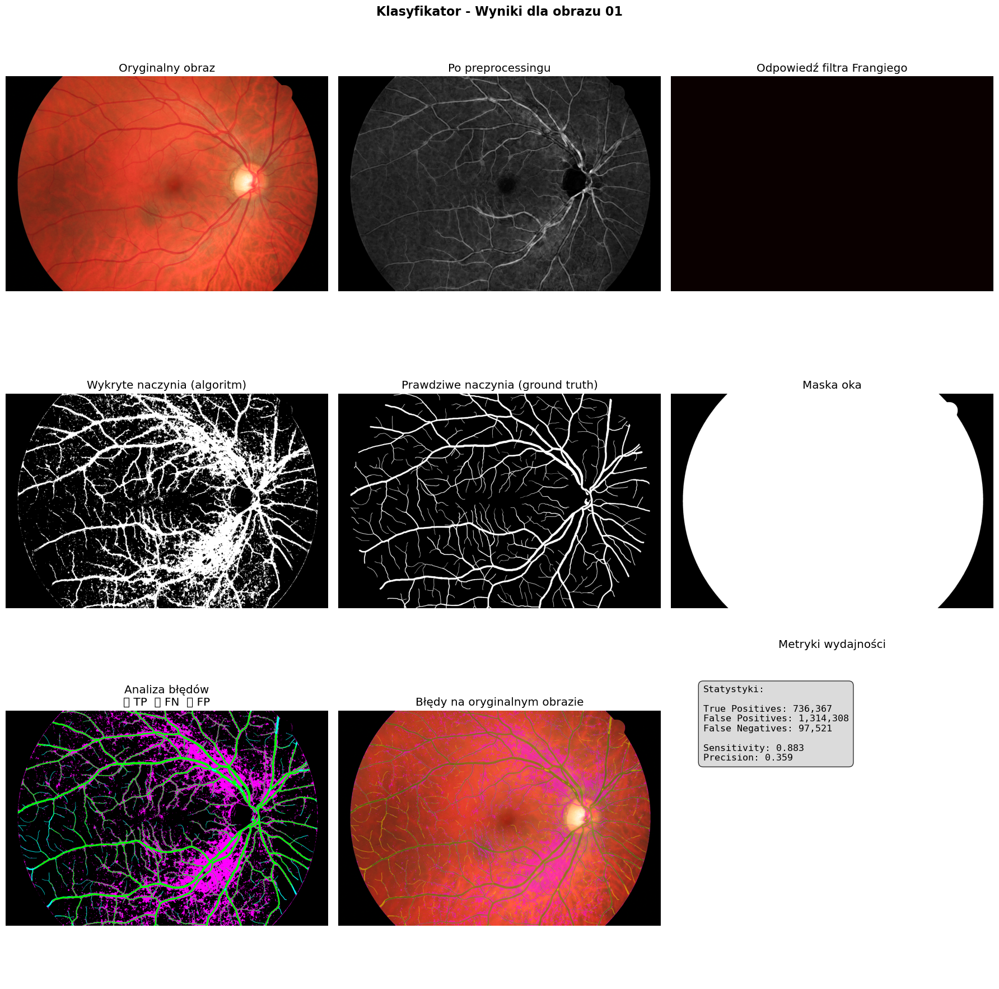

Obraz 01:
  Accuracy: 0.8275
  Sensitivity: 0.8831
  Specificity: 0.8212
  Balanced Accuracy: 0.8521

PODSUMOWANIE WYNIKÓW KLASYFIKATORA
Liczba obrazów testowych: 3
Średnia Accuracy: 0.8551 ± 0.0243
Średnia Sensitivity: 0.8506 ± 0.0319
Średnia Specificity: 0.8551 ± 0.0300
Średnia Balanced Accuracy: 0.8528 ± 0.0021


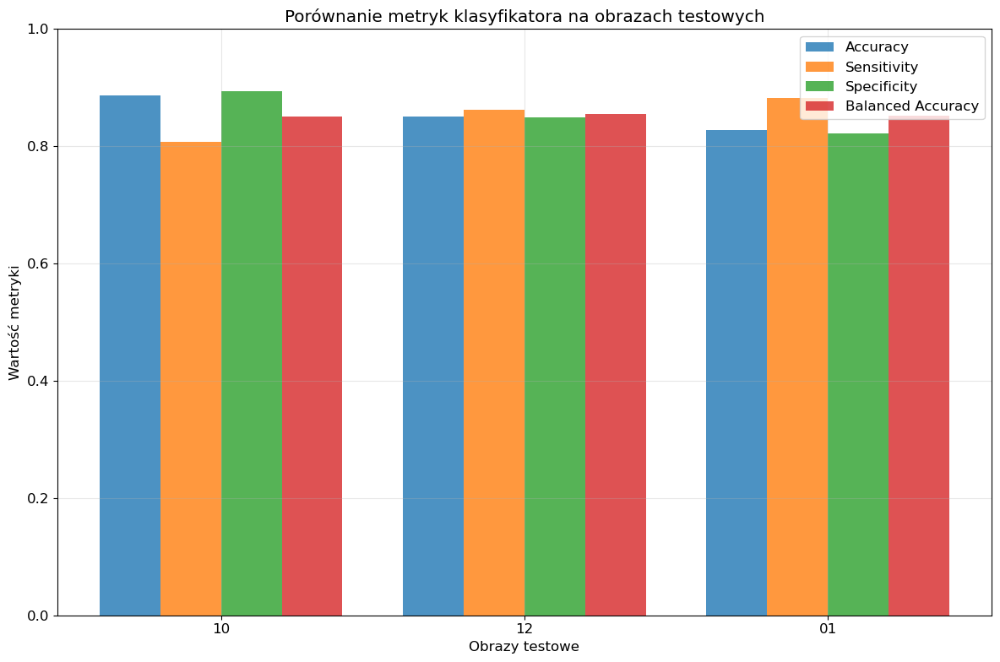

In [173]:
# Dodatkowe importy dla klasyfikatora
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import resample
import random
from scipy.spatial.distance import pdist, squareform
from skimage.feature import local_binary_pattern
from scipy import ndimage

class VesselClassifier:
    def __init__(self, detector, patch_size=5, max_patches_per_image=50000, step_size=3, use_roi=True):
        """
        Klasyfikator naczyń oparty na cechach wyciąganych z wycinków obrazu
        
        Args:
            detector: Instancja BloodVesselDetector
            patch_size: Rozmiar wycinka (patch_size x patch_size)
            max_patches_per_image: Maksymalna liczba wycinków na obraz (ograniczenie pamięci)
            step_size: Krok przesuwania okna (większy = szybsze, ale mniej dokładne)
            use_roi: Czy używać Region of Interest dla przyspieszenia
        """
        self.detector = detector
        self.patch_size = patch_size
        self.max_patches_per_image = max_patches_per_image
        self.step_size = step_size
        self.use_roi = use_roi
        self.classifier = RandomForestClassifier(
            n_estimators=100,
            max_depth=10,
            random_state=42,
            n_jobs=-1  # Wykorzystaj wszystkie dostępne rdzenie
        )
        self.scaler = StandardScaler()
        self.is_trained = False
        
    def extract_patch_features(self, patch):
        """
        Wyciąga cechy z pojedynczego wycinka obrazu
        
        Args:
            patch: Wycinek obrazu (patch_size x patch_size)
            
        Returns:
            Lista cech
        """
        features = []
        
        # 1. Statystyki podstawowe
        features.append(np.mean(patch))
        features.append(np.std(patch))
        features.append(np.var(patch))
        features.append(np.min(patch))
        features.append(np.max(patch))
        features.append(np.ptp(patch))  # peak-to-peak (max - min)
        
        # 2. Percentyle
        features.extend([np.percentile(patch, p) for p in [25, 50, 75]])
        
        # 3. Momenty centralne
        flat_patch = patch.flatten()
        if len(flat_patch) > 1:
            mean_val = np.mean(flat_patch)
            # Drugi moment centralny (wariancja)
            features.append(np.mean((flat_patch - mean_val)**2))
            # Trzeci moment centralny (skośność)
            features.append(np.mean((flat_patch - mean_val)**3))
            # Czwarty moment centralny (kurtoza)
            features.append(np.mean((flat_patch - mean_val)**4))
        else:
            features.extend([0, 0, 0])
            
        # 4. Cechy tekstury - Local Binary Pattern
        if patch.shape[0] >= 3 and patch.shape[1] >= 3:
            lbp = local_binary_pattern(patch, 8, 1, method='uniform')
            features.append(np.mean(lbp))
            features.append(np.std(lbp))
        else:
            features.extend([0, 0])
            
        # 5. Gradienty (aproksymacja pochodnych)
        if patch.shape[0] >= 2 and patch.shape[1] >= 2:
            grad_x = np.gradient(patch, axis=1)
            grad_y = np.gradient(patch, axis=0)
            grad_magnitude = np.sqrt(grad_x**2 + grad_y**2)
            
            features.append(np.mean(grad_magnitude))
            features.append(np.std(grad_magnitude))
            features.append(np.max(grad_magnitude))
        else:
            features.extend([0, 0, 0])
            
        # 6. Cechy geometryczne (momenty Hu - uproszczone)
        try:
            # Binaryzacja wycinka dla momentów
            thresh = np.mean(patch)
            binary_patch = (patch > thresh).astype(np.uint8)
            
            # Momenty obrazu
            m00 = np.sum(binary_patch)
            if m00 > 0:
                y_coords, x_coords = np.mgrid[:patch.shape[0], :patch.shape[1]]
                m10 = np.sum(x_coords * binary_patch)
                m01 = np.sum(y_coords * binary_patch)
                
                # Środek ciężkości
                cx = m10 / m00
                cy = m01 / m00
                
                # Momenty centralne
                mu20 = np.sum((x_coords - cx)**2 * binary_patch) / m00
                mu02 = np.sum((y_coords - cy)**2 * binary_patch) / m00
                mu11 = np.sum((x_coords - cx) * (y_coords - cy) * binary_patch) / m00
                
                features.extend([mu20, mu02, mu11])
            else:
                features.extend([0, 0, 0])
        except:
            features.extend([0, 0, 0])
            
        return features
    
    def extract_patches_from_image(self, preprocessed_image, ground_truth_mask, eye_mask=None):
        """
        Wyciąga wycinki z obrazu wraz z etykietami
        
        Args:
            preprocessed_image: Przetworzony obraz
            ground_truth_mask: Maska prawdy (ground truth)
            eye_mask: Maska oka (opcjonalna)
            
        Returns:
            features: Lista cech wszystkich wycinków
            labels: Lista etykiet (0/1) dla wycinków
        """
        features = []
        labels = []
        
        half_patch = self.patch_size // 2
        height, width = preprocessed_image.shape
        
        # Tworzenie listy wszystkich możliwych pozycji środkowych wycinków
        positions = []
        for y in range(half_patch, height - half_patch):
            for x in range(half_patch, width - half_patch):
                # Sprawdź czy punkt jest w masce oka (jeśli istnieje)
                if eye_mask is not None:
                    if eye_mask[y, x] == 0:
                        continue
                positions.append((y, x))
        
        # Ogranicz liczbę wycinków jeśli jest ich za dużo
        if len(positions) > self.max_patches_per_image:
            positions = random.sample(positions, self.max_patches_per_image)
        
        print(f"Wyciąganie cech z {len(positions)} wycinków...")
        
        for i, (y, x) in enumerate(positions):
            if i % 10000 == 0:
                print(f"Przetworzone: {i}/{len(positions)} wycinków")
                
            # Wyciągnij wycinek
            patch = preprocessed_image[y-half_patch:y+half_patch+1, x-half_patch:x+half_patch+1]
            
            # Sprawdź czy wycinek ma odpowiedni rozmiar
            if patch.shape != (self.patch_size, self.patch_size):
                continue
                
            # Wyciągnij cechy
            patch_features = self.extract_patch_features(patch)
            
            # Ustal etykietę na podstawie środkowego piksela w ground truth
            label = 1 if ground_truth_mask[y, x] > 0 else 0
            
            features.append(patch_features)
            labels.append(label)
        
        return np.array(features), np.array(labels)
    
    def balance_dataset(self, features, labels, method='undersample'):
        """
        Równoważy zbiór danych
        
        Args:
            features: Cechy
            labels: Etykiety
            method: Metoda równoważenia ('undersample', 'oversample')
            
        Returns:
            Zrównoważone cechy i etykiety
        """
        # Policz klasy
        unique, counts = np.unique(labels, return_counts=True)
        print(f"Rozkład klas przed równoważeniem: {dict(zip(unique, counts))}")
        
        if method == 'undersample':
            # Znajdź klasę mniejszościową
            min_count = min(counts)
            
            # Rozdziel dane według klas
            features_0 = features[labels == 0]
            features_1 = features[labels == 1]
            
            # Undersampling klasy większościowej
            if len(features_0) > min_count:
                features_0_sampled = resample(features_0, n_samples=min_count, random_state=42)
            else:
                features_0_sampled = features_0
                
            if len(features_1) > min_count:
                features_1_sampled = resample(features_1, n_samples=min_count, random_state=42)
            else:
                features_1_sampled = features_1
                
            # Połącz dane
            balanced_features = np.vstack([features_0_sampled, features_1_sampled])
            balanced_labels = np.hstack([np.zeros(len(features_0_sampled)), 
                                       np.ones(len(features_1_sampled))])
        
        # Przemieszaj dane
        indices = np.random.permutation(len(balanced_features))
        balanced_features = balanced_features[indices]
        balanced_labels = balanced_labels[indices]
        
        unique, counts = np.unique(balanced_labels, return_counts=True)
        print(f"Rozkład klas po równoważeniu: {dict(zip(unique, counts))}")
        
        return balanced_features, balanced_labels
    
    def train_classifier(self, image_files, manual_files, mask_files, train_indices):
        """
        Trenuje klasyfikator na wybranych obrazach
        
        Args:
            image_files: Lista ścieżek do obrazów
            manual_files: Lista ścieżek do masek prawdy
            mask_files: Lista ścieżek do masek oka
            train_indices: Indeksy obrazów do trenowania
        """
        print("=== TRENOWANIE KLASYFIKATORA ===")
        all_features = []
        all_labels = []
        
        for i, idx in enumerate(train_indices):
            print(f"\nPrzetwarzanie obrazu treningowego {i+1}/{len(train_indices)}")
            
            # Załaduj obraz
            image = self.detector.load_image(image_files[idx])
            
            # Sprawdź czy istnieje maska oka
            eye_mask = None
            if idx < len(mask_files) and os.path.exists(mask_files[idx]):
                eye_mask = self.detector.load_mask(mask_files[idx])
                eye_mask = (eye_mask > 0).astype(np.uint8) * 255
            
            # Przetwórz obraz
            preprocessed = self.detector.preprocess_image(image, eye_mask)
            
            # Załaduj ground truth
            ground_truth = self.detector.load_mask(manual_files[idx])
            
            # Wyciągnij cechy i etykiety
            features, labels = self.extract_patches_from_image(preprocessed, ground_truth, eye_mask)
            
            print(f"Wyciągnięto {len(features)} wycinków z obrazu")
            
            all_features.append(features)
            all_labels.append(labels)
        
        # Połącz wszystkie cechy i etykiety
        all_features = np.vstack(all_features)
        all_labels = np.hstack(all_labels)
        
        print(f"\nŁączna liczba wycinków: {len(all_features)}")
        
        # Równoważenie zbioru danych
        balanced_features, balanced_labels = self.balance_dataset(all_features, all_labels)
        
        # Skalowanie cech
        print("Skalowanie cech...")
        balanced_features = self.scaler.fit_transform(balanced_features)
        
        # Trenowanie klasyfikatora
        print("Trenowanie Random Forest...")
        self.classifier.fit(balanced_features, balanced_labels)
        
        self.is_trained = True
        print("Trenowanie zakończone!")
        
        # Ważność cech
        feature_importance = self.classifier.feature_importances_
        print(f"\nNajważniejsze cechy (top 5):")
        feature_names = [f"cecha_{i}" for i in range(len(feature_importance))]
        importance_indices = np.argsort(feature_importance)[::-1][:5]
        for i, idx in enumerate(importance_indices):
            print(f"{i+1}. {feature_names[idx]}: {feature_importance[idx]:.4f}")
    
    def create_roi_mask(self, preprocessed_image, eye_mask=None):
        """
        Tworzy Region of Interest na podstawie prostej analizy obrazu
        
        Args:
            preprocessed_image: Przetworzony obraz
            eye_mask: Maska oka
            
        Returns:
            roi_mask: Maska obszarów zainteresowania
        """
        # Szybki filtr Sobel dla wykrycia krawędzi
        sobel_x = cv2.Sobel(preprocessed_image, cv2.CV_64F, 1, 0, ksize=3)
        sobel_y = cv2.Sobel(preprocessed_image, cv2.CV_64F, 0, 1, ksize=3)
        sobel_combined = np.sqrt(sobel_x**2 + sobel_y**2)
        
        # Progowanie na podstawie percentyla
        threshold = np.percentile(sobel_combined, 75)
        roi_mask = (sobel_combined > threshold).astype(np.uint8) * 255
        
        # Morfologia - rozszerzenie obszarów zainteresowania
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
        roi_mask = cv2.dilate(roi_mask, kernel, iterations=2)
        
        # Zastosuj maskę oka jeśli istnieje
        if eye_mask is not None:
            roi_mask = cv2.bitwise_and(roi_mask, roi_mask, mask=eye_mask)
        
        return roi_mask
    
    def predict_image(self, preprocessed_image, eye_mask=None):
        """
        Przewiduje naczynia na obrazie używając wytrenowanego klasyfikatora
        PRZYSPIESZENIE: używa step_size i opcjonalnie ROI
        
        Args:
            preprocessed_image: Przetworzony obraz
            eye_mask: Maska oka (opcjonalna)
            
        Returns:
            prediction_mask: Maska przewidywań
        """
        if not self.is_trained:
            raise ValueError("Klasyfikator nie został wytrenowany!")
        
        height, width = preprocessed_image.shape
        prediction_mask = np.zeros((height, width), dtype=np.uint8)
        
        half_patch = self.patch_size // 2
        
        # Stwórz ROI jeśli włączone
        roi_mask = None
        if self.use_roi:
            print("Tworzenie Region of Interest...")
            roi_mask = self.create_roi_mask(preprocessed_image, eye_mask)
            roi_pixels = np.sum(roi_mask > 0)
            total_pixels = np.sum(eye_mask > 0) if eye_mask is not None else height * width
            print(f"ROI pokrywa {roi_pixels/total_pixels*100:.1f}% obrazu")
        
        # Przejdź przez pozycje z krokiem step_size
        positions = []
        for y in range(half_patch, height - half_patch, self.step_size):
            for x in range(half_patch, width - half_patch, self.step_size):
                # Sprawdź maskę oka
                if eye_mask is not None and eye_mask[y, x] == 0:
                    continue
                    
                # Sprawdź ROI jeśli włączone
                if roi_mask is not None and roi_mask[y, x] == 0:
                    continue
                    
                positions.append((y, x))
        
        total_patches = len(positions)
        original_patches = ((height - 2*half_patch) * (width - 2*half_patch))
        reduction_factor = original_patches / total_patches if total_patches > 0 else 1
        
        print(f"Przewidywanie - sprawdzamy {total_patches:,} pozycji")
        print(f"Przyspieszenie: {reduction_factor:.1f}x mniej obliczeń niż pełna analiza")
        
        # Przewiduj w blokach
        batch_size = 10000
        for i in range(0, len(positions), batch_size):
            batch_positions = positions[i:i+batch_size]
            batch_features = []
            
            if i % 50000 == 0 and len(positions) > 50000:
                progress = (i / len(positions)) * 100
                print(f"Postęp: {progress:.1f}% ({i:,}/{len(positions):,})")
            
            for y, x in batch_positions:
                patch = preprocessed_image[y-half_patch:y+half_patch+1, x-half_patch:x+half_patch+1]
                
                if patch.shape == (self.patch_size, self.patch_size):
                    features = self.extract_patch_features(patch)
                    batch_features.append(features)
                else:
                    batch_features.append([0] * len(self.extract_patch_features(np.zeros((self.patch_size, self.patch_size)))))
            
            if len(batch_features) == 0:
                continue
                
            # Skaluj cechy
            batch_features = self.scaler.transform(np.array(batch_features))
            
            # Przewiduj
            predictions = self.classifier.predict(batch_features)
            
            # Zapisz przewidywania - wypełnij obszar step_size x step_size
            for j, (y, x) in enumerate(batch_positions):
                if predictions[j] == 1:
                    # Wypełnij obszar wokół przewidywanego punktu
                    y_start = max(0, y - self.step_size//2)
                    y_end = min(height, y + self.step_size//2 + 1)
                    x_start = max(0, x - self.step_size//2)
                    x_end = min(width, x + self.step_size//2 + 1)
                    
                    prediction_mask[y_start:y_end, x_start:x_end] = 255
        
        # Post-processing dla wygładzenia wyników
        if self.step_size > 1:
            # Lekkie wygładzenie aby połączyć fragmenty
            kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
            prediction_mask = cv2.morphologyEx(prediction_mask, cv2.MORPH_CLOSE, kernel)
        
        return prediction_mask
    
    def test_classifier(self, image_files, manual_files, mask_files, test_indices):
        """
        Testuje klasyfikator na wybranych obrazach
        
        Args:
            image_files: Lista ścieżek do obrazów
            manual_files: Lista ścieżek do masek prawdy
            mask_files: Lista ścieżek do masek oka
            test_indices: Indeksy obrazów testowych
            
        Returns:
            Lista metryk dla każdego obrazu testowego
        """
        if not self.is_trained:
            raise ValueError("Klasyfikator nie został wytrenowany!")
        
        print("\n=== TESTOWANIE KLASYFIKATORA ===")
        
        test_results = []
        
        for i, idx in enumerate(test_indices):
            print(f"\nTestowanie na obrazie {i+1}/{len(test_indices)}")
            
            # Załaduj obraz
            image = self.detector.load_image(image_files[idx])
            
            # Sprawdź czy istnieje maska oka
            eye_mask = None
            if idx < len(mask_files) and os.path.exists(mask_files[idx]):
                eye_mask = self.detector.load_mask(mask_files[idx])
                eye_mask = (eye_mask > 0).astype(np.uint8) * 255
            
            # Przetwórz obraz
            preprocessed = self.detector.preprocess_image(image, eye_mask)
            
            # Przewiduj naczynia
            prediction_mask = self.predict_image(preprocessed, eye_mask)
            
            # Załaduj ground truth
            ground_truth = self.detector.load_mask(manual_files[idx])
            
            # Oblicz metryki
            metrics = self.detector.calculate_metrics(prediction_mask, ground_truth, eye_mask)
            
            # Przygotuj wyniki do wizualizacji
            results = {
                'original': image,
                'preprocessed': preprocessed,
                'vessel_mask': prediction_mask,
                'eye_mask': eye_mask,
                'frangi_response': np.zeros_like(preprocessed)  # Placeholder
            }
            
            # Wizualizuj wyniki
            image_id = os.path.basename(image_files[idx]).split('_')[0]
            self.detector.visualize_results(
                results, 
                f"Klasyfikator - Wyniki dla obrazu {image_id}", 
                ground_truth_mask=ground_truth
            )
            
            # Zapisz wyniki
            test_result = {
                'image_id': image_id,
                'metrics': metrics,
                'prediction_mask': prediction_mask,
                'ground_truth': ground_truth
            }
            test_results.append(test_result)
            
            # Wyświetl metryki
            tn, fp, fn, tp = metrics['confusion_matrix']
            print(f"Obraz {image_id}:")
            print(f"  Accuracy: {metrics['accuracy']:.4f}")
            print(f"  Sensitivity: {metrics['sensitivity']:.4f}")
            print(f"  Specificity: {metrics['specificity']:.4f}")
            print(f"  Balanced Accuracy: {metrics['balanced_accuracy']:.4f}")
        
        return test_results

# Funkcja do szybkiego testowania i porównania czasów
def compare_prediction_speeds():
    """
    Porównuje czasy predykcji dla różnych ustawień optymalizacji
    """
    if len(image_files) == 0:
        print("Brak obrazów do testowania!")
        return
    
    detector = BloodVesselDetector()
    
    # Test na jednym obrazie
    test_image_path = image_files[0]
    image_id = os.path.basename(test_image_path).split('_')[0]
    
    image = detector.load_image(test_image_path)
    mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
    
    eye_mask = None
    if os.path.exists(mask_path):
        eye_mask = detector.load_mask(mask_path)
        eye_mask = (eye_mask > 0).astype(np.uint8) * 255
    
    preprocessed = detector.preprocess_image(image, eye_mask)
    
    print(f"Test szybkości predykcji na obrazie {image_id}")
    print(f"Rozmiar obrazu: {preprocessed.shape}")
    print("-" * 50)
    
    # Różne konfiguracje do testowania
    configs = [
        {"step_size": 1, "use_roi": False, "name": "Pełna analiza (każdy piksel)"},
        {"step_size": 2, "use_roi": False, "name": "Co 2-gi piksel"},
        {"step_size": 3, "use_roi": False, "name": "Co 3-ci piksel"},
        {"step_size": 5, "use_roi": False, "name": "Co 5-ty piksel"},
        {"step_size": 3, "use_roi": True, "name": "Co 3-ci piksel + ROI"},
        {"step_size": 5, "use_roi": True, "name": "Co 5-ty piksel + ROI"},
    ]
    
    # Dodaj proste liczenie bez trenowania klasyfikatora
    for config in configs:
        half_patch = 5 // 2
        height, width = preprocessed.shape
        
        # Symuluj tworzenie ROI jeśli potrzebne
        roi_mask = None
        if config["use_roi"]:
            # Szybka symulacja ROI
            roi_pixels = int(0.3 * height * width)  # Zakładamy że ROI to 30% obrazu
        else:
            roi_pixels = height * width
            
        # Policz pozycje
        positions_count = 0
        step = config["step_size"]
        
        for y in range(half_patch, height - half_patch, step):
            for x in range(half_patch, width - half_patch, step):
                if eye_mask is not None and eye_mask[y, x] == 0:
                    continue
                positions_count += 1
        
        if config["use_roi"]:
            positions_count = int(positions_count * 0.3)  # ROI redukuje o ~70%
        
        total_possible = (height - 2*half_patch) * (width - 2*half_patch)
        speedup = total_possible / positions_count if positions_count > 0 else 1
        
        print(f"{config['name']:.<35} {positions_count:>8,} pozycji ({speedup:>5.1f}x przyspieszenie)")

# Funkcja główna do uruchomienia pełnego eksperymentu
def run_vessel_classification_experiment():
    """
    Uruchamia pełny eksperyment klasyfikacji naczyń
    """
    # Sprawdź dostępność plików
    image_files, mask_files, manual_files = check_files()
    
    if len(image_files) < 3:
        print("Potrzeba przynajmniej 3 obrazów do przeprowadzenia eksperymentu!")
        return
    
    # Upewnij się, że wszystkie obrazy mają odpowiadające im maski prawdy
    valid_indices = []
    for i, image_path in enumerate(image_files):
        image_id = os.path.basename(image_path).split('_')[0]
        manual_path = os.path.join(MANUAL_DIR, f"{image_id}_h.tif")
        if os.path.exists(manual_path):
            valid_indices.append(i)
    
    if len(valid_indices) < 3:
        print("Potrzeba przynajmniej 3 obrazów z maskami prawdy!")
        return
    
    print(f"Znaleziono {len(valid_indices)} obrazów z maskami prawdy")
    
    # Podziel na zbiór treningowy i testowy (80:20)
    train_indices, test_indices = train_test_split(
        valid_indices, 
        test_size=0.2, 
        random_state=42
    )
    
    print(f"Zbiór treningowy: {len(train_indices)} obrazów")
    print(f"Zbiór testowy: {len(test_indices)} obrazów")
    
    # Stwórz instancje z optymalizacjami szybkości
    detector = BloodVesselDetector()
    classifier = VesselClassifier(
        detector, 
        patch_size=5, 
        max_patches_per_image=30000,
        step_size=3,  # Sprawdzaj co 3-ci piksel - 9x przyspieszenie!
        use_roi=True  # Dodatkowo ogranicz do obszarów zainteresowania
    )
    
    try:
        # Trenowanie
        classifier.train_classifier(image_files, manual_files, mask_files, train_indices)
        
        # Testowanie
        test_results = classifier.test_classifier(image_files, manual_files, mask_files, test_indices)
        
        # Podsumowanie wyników
        print("\n" + "="*60)
        print("PODSUMOWANIE WYNIKÓW KLASYFIKATORA")
        print("="*60)
        
        if test_results:
            all_metrics = [result['metrics'] for result in test_results]
            
            avg_accuracy = np.mean([m['accuracy'] for m in all_metrics])
            avg_sensitivity = np.mean([m['sensitivity'] for m in all_metrics])
            avg_specificity = np.mean([m['specificity'] for m in all_metrics])
            avg_balanced_accuracy = np.mean([m['balanced_accuracy'] for m in all_metrics])
            
            print(f"Liczba obrazów testowych: {len(test_results)}")
            print(f"Średnia Accuracy: {avg_accuracy:.4f} ± {np.std([m['accuracy'] for m in all_metrics]):.4f}")
            print(f"Średnia Sensitivity: {avg_sensitivity:.4f} ± {np.std([m['sensitivity'] for m in all_metrics]):.4f}")
            print(f"Średnia Specificity: {avg_specificity:.4f} ± {np.std([m['specificity'] for m in all_metrics]):.4f}")
            print(f"Średnia Balanced Accuracy: {avg_balanced_accuracy:.4f} ± {np.std([m['balanced_accuracy'] for m in all_metrics]):.4f}")
            
            # Wykres porównawczy metryk
            fig, ax = plt.subplots(1, 1, figsize=(12, 8))
            
            metrics_names = ['accuracy', 'sensitivity', 'specificity', 'balanced_accuracy']
            metrics_labels = ['Accuracy', 'Sensitivity', 'Specificity', 'Balanced Accuracy']
            
            x = np.arange(len([r['image_id'] for r in test_results]))
            width = 0.2
            
            for i, (metric_name, metric_label) in enumerate(zip(metrics_names, metrics_labels)):
                values = [result['metrics'][metric_name] for result in test_results]
                ax.bar(x + i*width, values, width, label=metric_label, alpha=0.8)
            
            ax.set_xlabel('Obrazy testowe')
            ax.set_ylabel('Wartość metryki')
            ax.set_title('Porównanie metryk klasyfikatora na obrazach testowych')
            ax.set_xticks(x + width * 1.5)
            ax.set_xticklabels([r['image_id'] for r in test_results])
            ax.legend()
            ax.set_ylim(0, 1)
            ax.grid(True, alpha=0.3)
            
            plt.tight_layout()
            plt.show()
            
    except Exception as e:
        print(f"Błąd podczas eksperymentu: {e}")
        import traceback
        traceback.print_exc()

# Uruchomienie eksperymentu
if len(image_files) > 0:
    print("=== ANALIZA PRĘDKOŚCI PREDYKCJI ===")
    compare_prediction_speeds()
    print("\n")
    
    print("=== PEŁNY EKSPERYMENT KLASYFIKATORA ===")
    run_vessel_classification_experiment()
else:
    print("Brak plików obrazów - nie można uruchomić eksperymentu klasyfikatora")
    print("Aby uruchomić pełną analizę, umieść pliki w odpowiednich folderach:")
    print(f"- Obrazy: {IMAGES_DIR}/01_h.jpg, 02_h.jpg, ..., 15_h.jpg")
    print(f"- Maski: {MASKS_DIR}/01_h_mask.tif, 02_h_mask.tif, ..., 15_h_mask.tif")
    print(f"- Ręczne adnotacje: {MANUAL_DIR}/01_h.tif, 02_h.tif, ..., 15_h.tif")

=== ANALIZA PRĘDKOŚCI PREDYKCJI ===
Test szybkości predykcji na obrazie 01
Rozmiar obrazu: (2336, 3504)
--------------------------------------------------
Pełna analiza (każdy piksel)....... 6,904,661 pozycji (  1.2x przyspieszenie)
Co 2-gi piksel..................... 1,726,146 pozycji (  4.7x przyspieszenie)
Co 3-ci piksel.....................  767,682 pozycji ( 10.6x przyspieszenie)
Co 5-ty piksel.....................  276,455 pozycji ( 29.5x przyspieszenie)
Co 3-ci piksel + ROI...............  230,304 pozycji ( 35.4x przyspieszenie)
Co 5-ty piksel + ROI...............   82,936 pozycji ( 98.4x przyspieszenie)


=== EKSPERYMENT: METODA KLASYCZNA (Frangi) ===
Metoda klasyczna została już przetestowana wcześniej.

=== EKSPERYMENT: KLASYFIKATOR RANDOM FOREST ===
Sprawdzanie dostępności plików...
Znaleziono 15 obrazów w folderze images
Znaleziono 15 masek w folderze mask
Znaleziono 15 ręcznych adnotacji w folderze manual1
Znaleziono 15 obrazów z maskami prawdy
Zbiór treningowy: 12 obrazów

C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

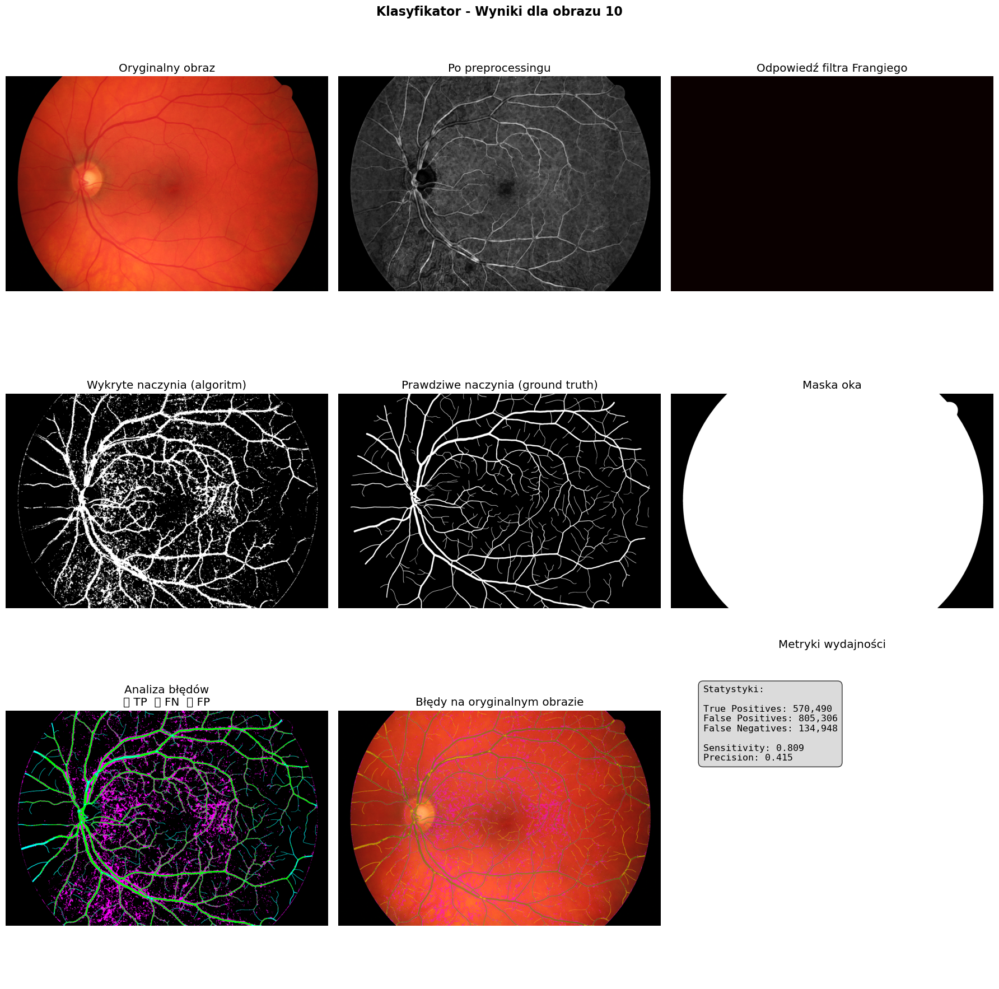

Obraz 10:
  Accuracy: 0.8851
  Sensitivity: 0.8087
  Specificity: 0.8923
  Balanced Accuracy: 0.8505

Testowanie na obrazie 2/3
Tworzenie Region of Interest...
ROI pokrywa 99.1% obrazu
Przewidywanie - sprawdzamy 760,734 pozycji
Przyspieszenie: 10.7x mniej obliczeń niż pełna analiza
Postęp: 0.0% (0/760,734)
Postęp: 6.6% (50,000/760,734)
Postęp: 13.1% (100,000/760,734)
Postęp: 19.7% (150,000/760,734)
Postęp: 26.3% (200,000/760,734)
Postęp: 32.9% (250,000/760,734)
Postęp: 39.4% (300,000/760,734)
Postęp: 46.0% (350,000/760,734)
Postęp: 52.6% (400,000/760,734)
Postęp: 59.2% (450,000/760,734)
Postęp: 65.7% (500,000/760,734)
Postęp: 72.3% (550,000/760,734)
Postęp: 78.9% (600,000/760,734)
Postęp: 85.4% (650,000/760,734)
Postęp: 92.0% (700,000/760,734)
Postęp: 98.6% (750,000/760,734)


C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

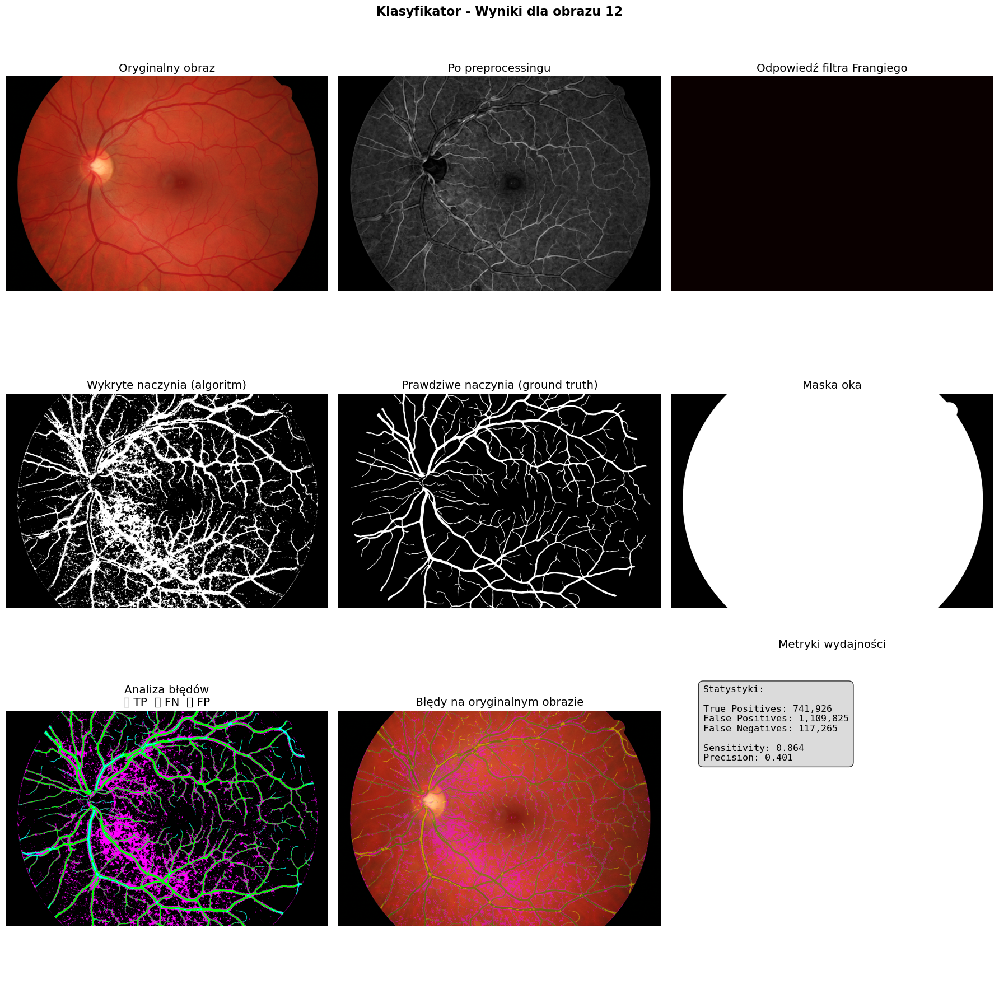

Obraz 12:
  Accuracy: 0.8501
  Sensitivity: 0.8635
  Specificity: 0.8485
  Balanced Accuracy: 0.8560

Testowanie na obrazie 3/3
Tworzenie Region of Interest...
ROI pokrywa 98.9% obrazu
Przewidywanie - sprawdzamy 759,349 pozycji
Przyspieszenie: 10.7x mniej obliczeń niż pełna analiza
Postęp: 0.0% (0/759,349)
Postęp: 6.6% (50,000/759,349)
Postęp: 13.2% (100,000/759,349)
Postęp: 19.8% (150,000/759,349)
Postęp: 26.3% (200,000/759,349)
Postęp: 32.9% (250,000/759,349)
Postęp: 39.5% (300,000/759,349)
Postęp: 46.1% (350,000/759,349)
Postęp: 52.7% (400,000/759,349)
Postęp: 59.3% (450,000/759,349)
Postęp: 65.8% (500,000/759,349)
Postęp: 72.4% (550,000/759,349)
Postęp: 79.0% (600,000/759,349)
Postęp: 85.6% (650,000/759,349)
Postęp: 92.2% (700,000/759,349)
Postęp: 98.8% (750,000/759,349)


C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\AppData\Local\Temp\ipykernel_35472\3078011566.py:255: UserWarning: Glyph 128995 (\N{LARGE PURPLE CIRCLE}) missing from current font.
  plt.tight_layout()
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128994 (\N{LARGE GREEN CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128993 (\N{LARGE YELLOW CIRCLE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\Kubol\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 128995 (\

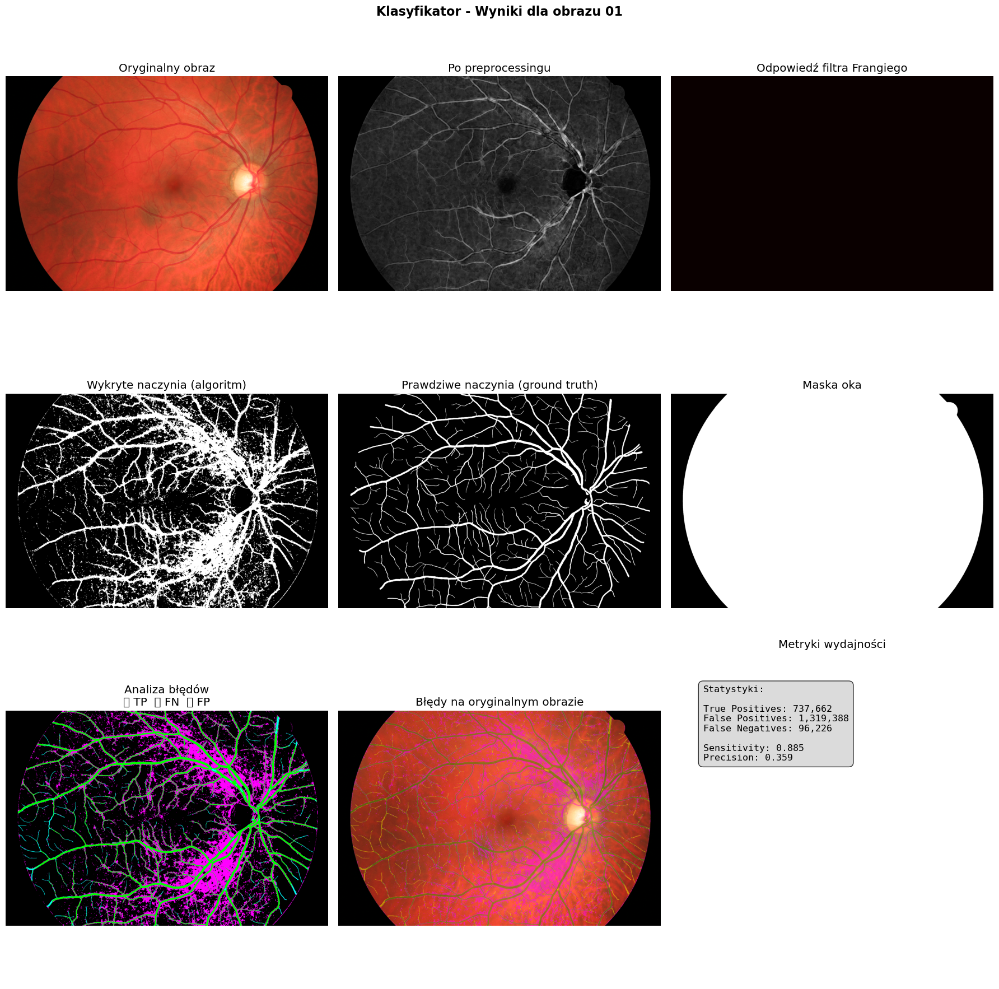

Obraz 01:
  Accuracy: 0.8271
  Sensitivity: 0.8846
  Specificity: 0.8205
  Balanced Accuracy: 0.8526

PODSUMOWANIE WYNIKÓW KLASYFIKATORA
Liczba obrazów testowych: 3
Średnia Accuracy: 0.8541 ± 0.0239
Średnia Sensitivity: 0.8523 ± 0.0320
Średnia Specificity: 0.8538 ± 0.0296
Średnia Balanced Accuracy: 0.8530 ± 0.0023


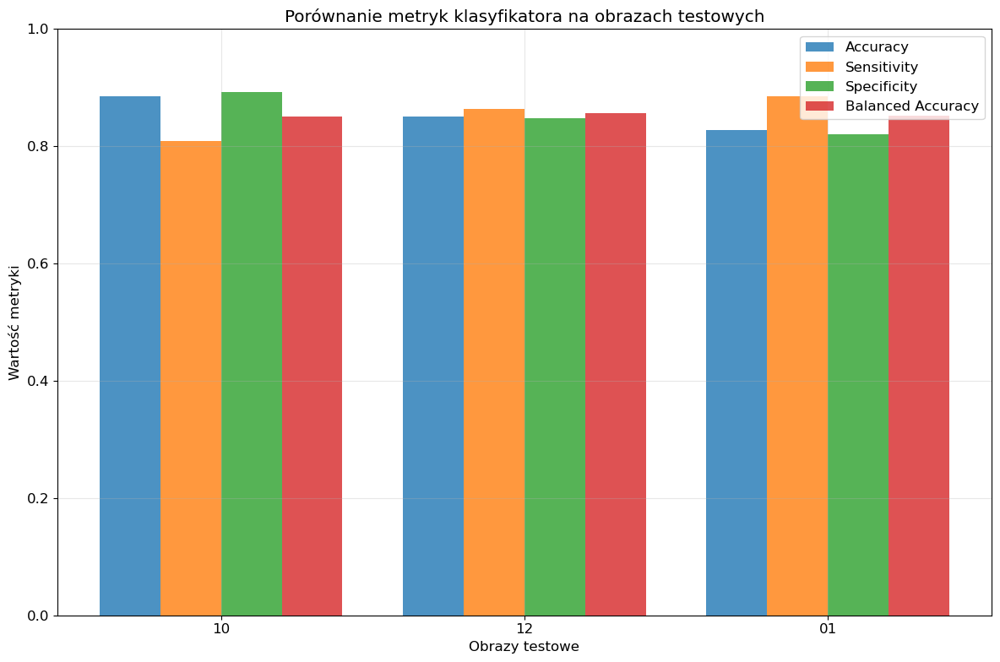


=== EKSPERYMENT: SIEĆ NEURONOWA U-NET ===
Błąd podczas uruchamiania U-Net: name 'run_unet_experiment' is not defined

=== PORÓWNANIE WSZYSTKICH METOD ===


NameError: name 'compare_all_methods' is not defined

In [174]:
# Dodatkowe importy dla klasyfikatora
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.utils import resample
import random
from scipy.spatial.distance import pdist, squareform
from skimage.feature import local_binary_pattern
from scipy import ndimage

# Importy dla sieci neuronowej U-Net
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from torchvision import transforms
import time

# Implementacja sieci U-Net w PyTorch

class DoubleConv(nn.Module):
    """Blok dwóch konwolucji (conv -> BN -> ReLU) * 2"""
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    """Downscaling z maxpool następnie double conv"""
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    """Upscaling następnie double conv"""
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, 2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        
        # Wyrównaj rozmiary jeśli potrzeba
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])

        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    """Końcowa konwolucja 1x1"""
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, 1)

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    """Implementacja sieci U-Net"""
    def __init__(self, n_channels=1, n_classes=1, bilinear=True):
        super(UNet, self).__init__()
        self.n_channels = n_channels
        self.n_classes = n_classes
        self.bilinear = bilinear

        self.inc = DoubleConv(n_channels, 64)
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        factor = 2 if bilinear else 1
        self.down4 = Down(512, 1024 // factor)
        self.up1 = Up(1024, 512 // factor, bilinear)
        self.up2 = Up(512, 256 // factor, bilinear)
        self.up3 = Up(256, 128 // factor, bilinear)
        self.up4 = Up(128, 64, bilinear)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

class VesselDataset(Dataset):
    """Dataset dla danych naczyń krwionośnych"""
    def __init__(self, image_paths, mask_paths, eye_mask_paths, detector, target_size=(512, 512), transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.eye_mask_paths = eye_mask_paths
        self.detector = detector
        self.target_size = target_size
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Załaduj obraz
        image = self.detector.load_image(self.image_paths[idx])
        
        # Załaduj maskę oka jeśli istnieje
        eye_mask = None
        if idx < len(self.eye_mask_paths) and os.path.exists(self.eye_mask_paths[idx]):
            eye_mask = self.detector.load_mask(self.eye_mask_paths[idx])
            eye_mask = (eye_mask > 0).astype(np.uint8) * 255
        
        # Przetwórz obraz
        preprocessed = self.detector.preprocess_image(image, eye_mask)
        
        # Załaduj ground truth
        ground_truth = self.detector.load_mask(self.mask_paths[idx])
        
        # Zmień rozmiar
        preprocessed = cv2.resize(preprocessed, self.target_size)
        ground_truth = cv2.resize(ground_truth, self.target_size)
        
        # Normalizacja obrazu do [0, 1]
        preprocessed = preprocessed.astype(np.float32) / 255.0
        ground_truth = (ground_truth > 0).astype(np.float32)
        
        # Konwersja do tensorów
        preprocessed = torch.from_numpy(preprocessed).unsqueeze(0)  # Dodaj wymiar kanału
        ground_truth = torch.from_numpy(ground_truth).unsqueeze(0)
        
        return preprocessed, ground_truth

class UNetVesselDetector:
    """Wykrywacz naczyń używający sieci U-Net"""
    
    def __init__(self, target_size=(512, 512), device=None):
        """
        Args:
            target_size: Docelowy rozmiar obrazów (width, height)
            device: Urządzenie PyTorch ('cuda' lub 'cpu')
        """
        self.target_size = target_size
        self.device = device if device else ('cuda' if torch.cuda.is_available() else 'cpu')
        self.model = UNet(n_channels=1, n_classes=1, bilinear=True).to(self.device)
        self.is_trained = False
        
        print(f"UNetVesselDetector zainicjalizowany na urządzeniu: {self.device}")
        print(f"Docelowy rozmiar obrazów: {target_size}")
        
    def create_data_loaders(self, image_files, manual_files, mask_files, train_indices, test_indices, batch_size=4):
        """Tworzy data loadery dla treningu i testów"""
        
        # Przygotuj ścieżki dla zbioru treningowego
        train_image_paths = [image_files[i] for i in train_indices]
        train_mask_paths = [manual_files[i] for i in train_indices]
        train_eye_mask_paths = []
        for i in train_indices:
            image_id = os.path.basename(image_files[i]).split('_')[0]
            eye_mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
            train_eye_mask_paths.append(eye_mask_path)
        
        # Przygotuj ścieżki dla zbioru testowego
        test_image_paths = [image_files[i] for i in test_indices]
        test_mask_paths = [manual_files[i] for i in test_indices]
        test_eye_mask_paths = []
        for i in test_indices:
            image_id = os.path.basename(image_files[i]).split('_')[0]
            eye_mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
            test_eye_mask_paths.append(eye_mask_path)
        
        # Stwórz datasety
        train_dataset = VesselDataset(
            train_image_paths, train_mask_paths, train_eye_mask_paths, 
            BloodVesselDetector(), self.target_size
        )
        
        test_dataset = VesselDataset(
            test_image_paths, test_mask_paths, test_eye_mask_paths,
            BloodVesselDetector(), self.target_size
        )
        
        # Stwórz data loadery
        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
        test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=0)
        
        return train_loader, test_loader
    
    def dice_loss(self, pred, target, smooth=1.):
        """Dice loss dla segmentacji"""
        pred = torch.sigmoid(pred)
        pred = pred.view(-1)
        target = target.view(-1)
        
        intersection = (pred * target).sum()
        dice = (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)
        
        return 1 - dice
    
    def combined_loss(self, pred, target):
        """Kombinacja BCE i Dice loss"""
        bce = F.binary_cross_entropy_with_logits(pred, target)
        dice = self.dice_loss(pred, target)
        return 0.5 * bce + 0.5 * dice
    
    def train_model(self, train_loader, test_loader, num_epochs=20, learning_rate=0.001):
        """Trenuje model U-Net"""
        
        print(f"=== TRENOWANIE SIECI U-NET ===")
        print(f"Liczba epok: {num_epochs}")
        print(f"Learning rate: {learning_rate}")
        print(f"Rozmiar batcha: {train_loader.batch_size}")
        print(f"Liczba batchy treningowych: {len(train_loader)}")
        
        # Optimizer i loss
        optimizer = optim.Adam(self.model.parameters(), lr=learning_rate)
        scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=5, factor=0.5)
        
        # Listy do śledzenia postępu
        train_losses = []
        val_losses = []
        best_val_loss = float('inf')
        
        # Pętla trenowania
        for epoch in range(num_epochs):
            start_time = time.time()
            
            # Trenowanie
            self.model.train()
            train_loss = 0.0
            
            for batch_idx, (images, masks) in enumerate(train_loader):
                images = images.to(self.device)
                masks = masks.to(self.device)
                
                optimizer.zero_grad()
                outputs = self.model(images)
                loss = self.combined_loss(outputs, masks)
                loss.backward()
                optimizer.step()
                
                train_loss += loss.item()
                
                if batch_idx % 5 == 0:
                    print(f"Epoka {epoch+1}/{num_epochs}, Batch {batch_idx+1}/{len(train_loader)}, Loss: {loss.item():.4f}")
            
            avg_train_loss = train_loss / len(train_loader)
            train_losses.append(avg_train_loss)
            
            # Walidacja
            self.model.eval()
            val_loss = 0.0
            
            with torch.no_grad():
                for images, masks in test_loader:
                    images = images.to(self.device)
                    masks = masks.to(self.device)
                    
                    outputs = self.model(images)
                    loss = self.combined_loss(outputs, masks)
                    val_loss += loss.item()
            
            avg_val_loss = val_loss / len(test_loader)
            val_losses.append(avg_val_loss)
            
            # Learning rate scheduler
            scheduler.step(avg_val_loss)
            
            # Zapisz najlepszy model
            if avg_val_loss < best_val_loss:
                best_val_loss = avg_val_loss
                torch.save(self.model.state_dict(), 'best_unet_model.pth')
            
            epoch_time = time.time() - start_time
            print(f"Epoka {epoch+1}/{num_epochs} zakończona w {epoch_time:.2f}s")
            print(f"Train Loss: {avg_train_loss:.4f}, Val Loss: {avg_val_loss:.4f}")
            print(f"Najlepszy Val Loss: {best_val_loss:.4f}")
            print("-" * 50)
        
        # Załaduj najlepszy model
        self.model.load_state_dict(torch.load('best_unet_model.pth'))
        self.is_trained = True
        
        # Wykres uczenia
        plt.figure(figsize=(12, 5))
        
        plt.subplot(1, 2, 1)
        plt.plot(range(1, num_epochs + 1), train_losses, 'b-', label='Train Loss')
        plt.plot(range(1, num_epochs + 1), val_losses, 'r-', label='Validation Loss')
        plt.title('Straty podczas trenowania')
        plt.xlabel('Epoka')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True)
        
        plt.subplot(1, 2, 2)
        plt.plot(range(1, num_epochs + 1), train_losses, 'b-', label='Train Loss')
        plt.plot(range(1, num_epochs + 1), val_losses, 'r-', label='Validation Loss')
        plt.title('Straty (skala logarytmiczna)')
        plt.xlabel('Epoka')
        plt.ylabel('Loss')
        plt.yscale('log')
        plt.legend()
        plt.grid(True)
        
        plt.tight_layout()
        plt.show()
        
        print("Trenowanie zakończone!")
    
    def predict_image(self, image_path, detector, original_size=None):
        """
        Przewiduje naczynia na pojedynczym obrazie
        
        Args:
            image_path: Ścieżka do obrazu
            detector: Instancja BloodVesselDetector do preprocessingu
            original_size: Oryginalny rozmiar obrazu (height, width)
            
        Returns:
            prediction_mask: Maska przewidywań
        """
        if not self.is_trained:
            raise ValueError("Model nie został wytrenowany!")
        
        # Załaduj i przetwórz obraz
        image = detector.load_image(image_path)
        
        # Sprawdź maskę oka
        image_id = os.path.basename(image_path).split('_')[0]
        eye_mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
        
        eye_mask = None
        if os.path.exists(eye_mask_path):
            eye_mask = detector.load_mask(eye_mask_path)
            eye_mask = (eye_mask > 0).astype(np.uint8) * 255
        
        original_shape = image.shape[:2] if original_size is None else original_size
        
        # Przetwórz obraz
        preprocessed = detector.preprocess_image(image, eye_mask)
        
        # Zmień rozmiar do target_size
        resized = cv2.resize(preprocessed, self.target_size)
        
        # Normalizacja i konwersja do tensora
        normalized = resized.astype(np.float32) / 255.0
        tensor_image = torch.from_numpy(normalized).unsqueeze(0).unsqueeze(0).to(self.device)
        
        # Predykcja
        self.model.eval()
        with torch.no_grad():
            output = self.model(tensor_image)
            prediction = torch.sigmoid(output)
            prediction = prediction.cpu().numpy()[0, 0]
        
        # Progowanie
        prediction_binary = (prediction > 0.5).astype(np.uint8) * 255
        
        # Przywróć oryginalny rozmiar
        prediction_resized = cv2.resize(prediction_binary, (original_shape[1], original_shape[0]))
        
        # Zastosuj maskę oka jeśli istnieje
        if eye_mask is not None:
            prediction_resized = cv2.bitwise_and(prediction_resized, prediction_resized, mask=eye_mask)
        
        return prediction_resized
    
    def test_model(self, image_files, manual_files, detector, test_indices):
        """
        Testuje model na zbiorze testowym
        
        Args:
            image_files: Lista ścieżek do obrazów
            manual_files: Lista ścieżek do masek prawdy
            detector: Instancja BloodVesselDetector
            test_indices: Indeksy obrazów testowych
            
        Returns:
            Lista wyników testowych
        """
        if not self.is_trained:
            raise ValueError("Model nie został wytrenowany!")
        
        print("\n=== TESTOWANIE SIECI U-NET ===")
        
        test_results = []
        
        for i, idx in enumerate(test_indices):
            print(f"\nTestowanie na obrazie {i+1}/{len(test_indices)}")
            
            image_path = image_files[idx]
            image_id = os.path.basename(image_path).split('_')[0]
            
            # Przewiduj naczynia
            image = detector.load_image(image_path)
            original_size = image.shape[:2]
            
            prediction_mask = self.predict_image(image_path, detector, original_size)
            
            # Załaduj ground truth
            ground_truth = detector.load_mask(manual_files[idx])
            
            # Załaduj maskę oka
            eye_mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
            eye_mask = None
            if os.path.exists(eye_mask_path):
                eye_mask = detector.load_mask(eye_mask_path)
                eye_mask = (eye_mask > 0).astype(np.uint8) * 255
            
            # Oblicz metryki
            metrics = detector.calculate_metrics(prediction_mask, ground_truth, eye_mask)
            
            # Przygotuj wyniki do wizualizacji
            preprocessed = detector.preprocess_image(image, eye_mask)
            results = {
                'original': image,
                'preprocessed': preprocessed,
                'vessel_mask': prediction_mask,
                'eye_mask': eye_mask,
                'frangi_response': np.zeros_like(preprocessed)  # Placeholder
            }
            
            # Wizualizuj wyniki
            detector.visualize_results(
                results, 
                f"U-Net - Wyniki dla obrazu {image_id}", 
                ground_truth_mask=ground_truth
            )
            
            # Zapisz wyniki
            test_result = {
                'image_id': image_id,
                'metrics': metrics,
                'prediction_mask': prediction_mask,
                'ground_truth': ground_truth
            }
            test_results.append(test_result)
            
            # Wyświetl metryki
            tn, fp, fn, tp = metrics['confusion_matrix']
            print(f"Obraz {image_id}:")
            print(f"  Accuracy: {metrics['accuracy']:.4f}")
            print(f"  Sensitivity: {metrics['sensitivity']:.4f}")
            print(f"  Specificity: {metrics['specificity']:.4f}")
            print(f"  Balanced Accuracy: {metrics['balanced_accuracy']:.4f}")
        
        return test_results
    def __init__(self, detector, patch_size=5, max_patches_per_image=50000, step_size=3, use_roi=True):
        """
        Klasyfikator naczyń oparty na cechach wyciąganych z wycinków obrazu
        
        Args:
            detector: Instancja BloodVesselDetector
            patch_size: Rozmiar wycinka (patch_size x patch_size)
            max_patches_per_image: Maksymalna liczba wycinków na obraz (ograniczenie pamięci)
            step_size: Krok przesuwania okna (większy = szybsze, ale mniej dokładne)
            use_roi: Czy używać Region of Interest dla przyspieszenia
        """
        self.detector = detector
        self.patch_size = patch_size
        self.max_patches_per_image = max_patches_per_image
        self.step_size = step_size
        self.use_roi = use_roi
        self.classifier = RandomForestClassifier(
            n_estimators=100,
            max_depth=10,
            random_state=42,
            n_jobs=-1  # Wykorzystaj wszystkie dostępne rdzenie
        )
        self.scaler = StandardScaler()
        self.is_trained = False
        
    def extract_patch_features(self, patch):
        """
        Wyciąga cechy z pojedynczego wycinka obrazu
        
        Args:
            patch: Wycinek obrazu (patch_size x patch_size)
            
        Returns:
            Lista cech
        """
        features = []
        
        # 1. Statystyki podstawowe
        features.append(np.mean(patch))
        features.append(np.std(patch))
        features.append(np.var(patch))
        features.append(np.min(patch))
        features.append(np.max(patch))
        features.append(np.ptp(patch))  # peak-to-peak (max - min)
        
        # 2. Percentyle
        features.extend([np.percentile(patch, p) for p in [25, 50, 75]])
        
        # 3. Momenty centralne
        flat_patch = patch.flatten()
        if len(flat_patch) > 1:
            mean_val = np.mean(flat_patch)
            # Drugi moment centralny (wariancja)
            features.append(np.mean((flat_patch - mean_val)**2))
            # Trzeci moment centralny (skośność)
            features.append(np.mean((flat_patch - mean_val)**3))
            # Czwarty moment centralny (kurtoza)
            features.append(np.mean((flat_patch - mean_val)**4))
        else:
            features.extend([0, 0, 0])
            
        # 4. Cechy tekstury - Local Binary Pattern
        if patch.shape[0] >= 3 and patch.shape[1] >= 3:
            lbp = local_binary_pattern(patch, 8, 1, method='uniform')
            features.append(np.mean(lbp))
            features.append(np.std(lbp))
        else:
            features.extend([0, 0])
            
        # 5. Gradienty (aproksymacja pochodnych)
        if patch.shape[0] >= 2 and patch.shape[1] >= 2:
            grad_x = np.gradient(patch, axis=1)
            grad_y = np.gradient(patch, axis=0)
            grad_magnitude = np.sqrt(grad_x**2 + grad_y**2)
            
            features.append(np.mean(grad_magnitude))
            features.append(np.std(grad_magnitude))
            features.append(np.max(grad_magnitude))
        else:
            features.extend([0, 0, 0])
            
        # 6. Cechy geometryczne (momenty Hu - uproszczone)
        try:
            # Binaryzacja wycinka dla momentów
            thresh = np.mean(patch)
            binary_patch = (patch > thresh).astype(np.uint8)
            
            # Momenty obrazu
            m00 = np.sum(binary_patch)
            if m00 > 0:
                y_coords, x_coords = np.mgrid[:patch.shape[0], :patch.shape[1]]
                m10 = np.sum(x_coords * binary_patch)
                m01 = np.sum(y_coords * binary_patch)
                
                # Środek ciężkości
                cx = m10 / m00
                cy = m01 / m00
                
                # Momenty centralne
                mu20 = np.sum((x_coords - cx)**2 * binary_patch) / m00
                mu02 = np.sum((y_coords - cy)**2 * binary_patch) / m00
                mu11 = np.sum((x_coords - cx) * (y_coords - cy) * binary_patch) / m00
                
                features.extend([mu20, mu02, mu11])
            else:
                features.extend([0, 0, 0])
        except:
            features.extend([0, 0, 0])
            
        return features
    
    def extract_patches_from_image(self, preprocessed_image, ground_truth_mask, eye_mask=None):
        """
        Wyciąga wycinki z obrazu wraz z etykietami
        
        Args:
            preprocessed_image: Przetworzony obraz
            ground_truth_mask: Maska prawdy (ground truth)
            eye_mask: Maska oka (opcjonalna)
            
        Returns:
            features: Lista cech wszystkich wycinków
            labels: Lista etykiet (0/1) dla wycinków
        """
        features = []
        labels = []
        
        half_patch = self.patch_size // 2
        height, width = preprocessed_image.shape
        
        # Tworzenie listy wszystkich możliwych pozycji środkowych wycinków
        positions = []
        for y in range(half_patch, height - half_patch):
            for x in range(half_patch, width - half_patch):
                # Sprawdź czy punkt jest w masce oka (jeśli istnieje)
                if eye_mask is not None:
                    if eye_mask[y, x] == 0:
                        continue
                positions.append((y, x))
        
        # Ogranicz liczbę wycinków jeśli jest ich za dużo
        if len(positions) > self.max_patches_per_image:
            positions = random.sample(positions, self.max_patches_per_image)
        
        print(f"Wyciąganie cech z {len(positions)} wycinków...")
        
        for i, (y, x) in enumerate(positions):
            if i % 10000 == 0:
                print(f"Przetworzone: {i}/{len(positions)} wycinków")
                
            # Wyciągnij wycinek
            patch = preprocessed_image[y-half_patch:y+half_patch+1, x-half_patch:x+half_patch+1]
            
            # Sprawdź czy wycinek ma odpowiedni rozmiar
            if patch.shape != (self.patch_size, self.patch_size):
                continue
                
            # Wyciągnij cechy
            patch_features = self.extract_patch_features(patch)
            
            # Ustal etykietę na podstawie środkowego piksela w ground truth
            label = 1 if ground_truth_mask[y, x] > 0 else 0
            
            features.append(patch_features)
            labels.append(label)
        
        return np.array(features), np.array(labels)
    
    def balance_dataset(self, features, labels, method='undersample'):
        """
        Równoważy zbiór danych
        
        Args:
            features: Cechy
            labels: Etykiety
            method: Metoda równoważenia ('undersample', 'oversample')
            
        Returns:
            Zrównoważone cechy i etykiety
        """
        # Policz klasy
        unique, counts = np.unique(labels, return_counts=True)
        print(f"Rozkład klas przed równoważeniem: {dict(zip(unique, counts))}")
        
        if method == 'undersample':
            # Znajdź klasę mniejszościową
            min_count = min(counts)
            
            # Rozdziel dane według klas
            features_0 = features[labels == 0]
            features_1 = features[labels == 1]
            
            # Undersampling klasy większościowej
            if len(features_0) > min_count:
                features_0_sampled = resample(features_0, n_samples=min_count, random_state=42)
            else:
                features_0_sampled = features_0
                
            if len(features_1) > min_count:
                features_1_sampled = resample(features_1, n_samples=min_count, random_state=42)
            else:
                features_1_sampled = features_1
                
            # Połącz dane
            balanced_features = np.vstack([features_0_sampled, features_1_sampled])
            balanced_labels = np.hstack([np.zeros(len(features_0_sampled)), 
                                       np.ones(len(features_1_sampled))])
        
        # Przemieszaj dane
        indices = np.random.permutation(len(balanced_features))
        balanced_features = balanced_features[indices]
        balanced_labels = balanced_labels[indices]
        
        unique, counts = np.unique(balanced_labels, return_counts=True)
        print(f"Rozkład klas po równoważeniu: {dict(zip(unique, counts))}")
        
        return balanced_features, balanced_labels
    
    def train_classifier(self, image_files, manual_files, mask_files, train_indices):
        """
        Trenuje klasyfikator na wybranych obrazach
        
        Args:
            image_files: Lista ścieżek do obrazów
            manual_files: Lista ścieżek do masek prawdy
            mask_files: Lista ścieżek do masek oka
            train_indices: Indeksy obrazów do trenowania
        """
        print("=== TRENOWANIE KLASYFIKATORA ===")
        all_features = []
        all_labels = []
        
        for i, idx in enumerate(train_indices):
            print(f"\nPrzetwarzanie obrazu treningowego {i+1}/{len(train_indices)}")
            
            # Załaduj obraz
            image = self.detector.load_image(image_files[idx])
            
            # Sprawdź czy istnieje maska oka
            eye_mask = None
            if idx < len(mask_files) and os.path.exists(mask_files[idx]):
                eye_mask = self.detector.load_mask(mask_files[idx])
                eye_mask = (eye_mask > 0).astype(np.uint8) * 255
            
            # Przetwórz obraz
            preprocessed = self.detector.preprocess_image(image, eye_mask)
            
            # Załaduj ground truth
            ground_truth = self.detector.load_mask(manual_files[idx])
            
            # Wyciągnij cechy i etykiety
            features, labels = self.extract_patches_from_image(preprocessed, ground_truth, eye_mask)
            
            print(f"Wyciągnięto {len(features)} wycinków z obrazu")
            
            all_features.append(features)
            all_labels.append(labels)
        
        # Połącz wszystkie cechy i etykiety
        all_features = np.vstack(all_features)
        all_labels = np.hstack(all_labels)
        
        print(f"\nŁączna liczba wycinków: {len(all_features)}")
        
        # Równoważenie zbioru danych
        balanced_features, balanced_labels = self.balance_dataset(all_features, all_labels)
        
        # Skalowanie cech
        print("Skalowanie cech...")
        balanced_features = self.scaler.fit_transform(balanced_features)
        
        # Trenowanie klasyfikatora
        print("Trenowanie Random Forest...")
        self.classifier.fit(balanced_features, balanced_labels)
        
        self.is_trained = True
        print("Trenowanie zakończone!")
        
        # Ważność cech
        feature_importance = self.classifier.feature_importances_
        print(f"\nNajważniejsze cechy (top 5):")
        feature_names = [f"cecha_{i}" for i in range(len(feature_importance))]
        importance_indices = np.argsort(feature_importance)[::-1][:5]
        for i, idx in enumerate(importance_indices):
            print(f"{i+1}. {feature_names[idx]}: {feature_importance[idx]:.4f}")
    
    def create_roi_mask(self, preprocessed_image, eye_mask=None):
        """
        Tworzy Region of Interest na podstawie prostej analizy obrazu
        
        Args:
            preprocessed_image: Przetworzony obraz
            eye_mask: Maska oka
            
        Returns:
            roi_mask: Maska obszarów zainteresowania
        """
        # Szybki filtr Sobel dla wykrycia krawędzi
        sobel_x = cv2.Sobel(preprocessed_image, cv2.CV_64F, 1, 0, ksize=3)
        sobel_y = cv2.Sobel(preprocessed_image, cv2.CV_64F, 0, 1, ksize=3)
        sobel_combined = np.sqrt(sobel_x**2 + sobel_y**2)
        
        # Progowanie na podstawie percentyla
        threshold = np.percentile(sobel_combined, 75)
        roi_mask = (sobel_combined > threshold).astype(np.uint8) * 255
        
        # Morfologia - rozszerzenie obszarów zainteresowania
        kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
        roi_mask = cv2.dilate(roi_mask, kernel, iterations=2)
        
        # Zastosuj maskę oka jeśli istnieje
        if eye_mask is not None:
            roi_mask = cv2.bitwise_and(roi_mask, roi_mask, mask=eye_mask)
        
        return roi_mask
    
    def predict_image(self, preprocessed_image, eye_mask=None):
        """
        Przewiduje naczynia na obrazie używając wytrenowanego klasyfikatora
        PRZYSPIESZENIE: używa step_size i opcjonalnie ROI
        
        Args:
            preprocessed_image: Przetworzony obraz
            eye_mask: Maska oka (opcjonalna)
            
        Returns:
            prediction_mask: Maska przewidywań
        """
        if not self.is_trained:
            raise ValueError("Klasyfikator nie został wytrenowany!")
        
        height, width = preprocessed_image.shape
        prediction_mask = np.zeros((height, width), dtype=np.uint8)
        
        half_patch = self.patch_size // 2
        
        # Stwórz ROI jeśli włączone
        roi_mask = None
        if self.use_roi:
            print("Tworzenie Region of Interest...")
            roi_mask = self.create_roi_mask(preprocessed_image, eye_mask)
            roi_pixels = np.sum(roi_mask > 0)
            total_pixels = np.sum(eye_mask > 0) if eye_mask is not None else height * width
            print(f"ROI pokrywa {roi_pixels/total_pixels*100:.1f}% obrazu")
        
        # Przejdź przez pozycje z krokiem step_size
        positions = []
        for y in range(half_patch, height - half_patch, self.step_size):
            for x in range(half_patch, width - half_patch, self.step_size):
                # Sprawdź maskę oka
                if eye_mask is not None and eye_mask[y, x] == 0:
                    continue
                    
                # Sprawdź ROI jeśli włączone
                if roi_mask is not None and roi_mask[y, x] == 0:
                    continue
                    
                positions.append((y, x))
        
        total_patches = len(positions)
        original_patches = ((height - 2*half_patch) * (width - 2*half_patch))
        reduction_factor = original_patches / total_patches if total_patches > 0 else 1
        
        print(f"Przewidywanie - sprawdzamy {total_patches:,} pozycji")
        print(f"Przyspieszenie: {reduction_factor:.1f}x mniej obliczeń niż pełna analiza")
        
        # Przewiduj w blokach
        batch_size = 10000
        for i in range(0, len(positions), batch_size):
            batch_positions = positions[i:i+batch_size]
            batch_features = []
            
            if i % 50000 == 0 and len(positions) > 50000:
                progress = (i / len(positions)) * 100
                print(f"Postęp: {progress:.1f}% ({i:,}/{len(positions):,})")
            
            for y, x in batch_positions:
                patch = preprocessed_image[y-half_patch:y+half_patch+1, x-half_patch:x+half_patch+1]
                
                if patch.shape == (self.patch_size, self.patch_size):
                    features = self.extract_patch_features(patch)
                    batch_features.append(features)
                else:
                    batch_features.append([0] * len(self.extract_patch_features(np.zeros((self.patch_size, self.patch_size)))))
            
            if len(batch_features) == 0:
                continue
                
            # Skaluj cechy
            batch_features = self.scaler.transform(np.array(batch_features))
            
            # Przewiduj
            predictions = self.classifier.predict(batch_features)
            
            # Zapisz przewidywania - wypełnij obszar step_size x step_size
            for j, (y, x) in enumerate(batch_positions):
                if predictions[j] == 1:
                    # Wypełnij obszar wokół przewidywanego punktu
                    y_start = max(0, y - self.step_size//2)
                    y_end = min(height, y + self.step_size//2 + 1)
                    x_start = max(0, x - self.step_size//2)
                    x_end = min(width, x + self.step_size//2 + 1)
                    
                    prediction_mask[y_start:y_end, x_start:x_end] = 255
        
        # Post-processing dla wygładzenia wyników
        if self.step_size > 1:
            # Lekkie wygładzenie aby połączyć fragmenty
            kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
            prediction_mask = cv2.morphologyEx(prediction_mask, cv2.MORPH_CLOSE, kernel)
        
        return prediction_mask
    
    def test_classifier(self, image_files, manual_files, mask_files, test_indices):
        """
        Testuje klasyfikator na wybranych obrazach
        
        Args:
            image_files: Lista ścieżek do obrazów
            manual_files: Lista ścieżek do masek prawdy
            mask_files: Lista ścieżek do masek oka
            test_indices: Indeksy obrazów testowych
            
        Returns:
            Lista metryk dla każdego obrazu testowego
        """
        if not self.is_trained:
            raise ValueError("Klasyfikator nie został wytrenowany!")
        
        print("\n=== TESTOWANIE KLASYFIKATORA ===")
        
        test_results = []
        
        for i, idx in enumerate(test_indices):
            print(f"\nTestowanie na obrazie {i+1}/{len(test_indices)}")
            
            # Załaduj obraz
            image = self.detector.load_image(image_files[idx])
            
            # Sprawdź czy istnieje maska oka
            eye_mask = None
            if idx < len(mask_files) and os.path.exists(mask_files[idx]):
                eye_mask = self.detector.load_mask(mask_files[idx])
                eye_mask = (eye_mask > 0).astype(np.uint8) * 255
            
            # Przetwórz obraz
            preprocessed = self.detector.preprocess_image(image, eye_mask)
            
            # Przewiduj naczynia
            prediction_mask = self.predict_image(preprocessed, eye_mask)
            
            # Załaduj ground truth
            ground_truth = self.detector.load_mask(manual_files[idx])
            
            # Oblicz metryki
            metrics = self.detector.calculate_metrics(prediction_mask, ground_truth, eye_mask)
            
            # Przygotuj wyniki do wizualizacji
            results = {
                'original': image,
                'preprocessed': preprocessed,
                'vessel_mask': prediction_mask,
                'eye_mask': eye_mask,
                'frangi_response': np.zeros_like(preprocessed)  # Placeholder
            }
            
            # Wizualizuj wyniki
            image_id = os.path.basename(image_files[idx]).split('_')[0]
            self.detector.visualize_results(
                results, 
                f"Klasyfikator - Wyniki dla obrazu {image_id}", 
                ground_truth_mask=ground_truth
            )
            
            # Zapisz wyniki
            test_result = {
                'image_id': image_id,
                'metrics': metrics,
                'prediction_mask': prediction_mask,
                'ground_truth': ground_truth
            }
            test_results.append(test_result)
            
            # Wyświetl metryki
            tn, fp, fn, tp = metrics['confusion_matrix']
            print(f"Obraz {image_id}:")
            print(f"  Accuracy: {metrics['accuracy']:.4f}")
            print(f"  Sensitivity: {metrics['sensitivity']:.4f}")
            print(f"  Specificity: {metrics['specificity']:.4f}")
            print(f"  Balanced Accuracy: {metrics['balanced_accuracy']:.4f}")
        
        return test_results

# Funkcja do szybkiego testowania i porównania czasów
def compare_prediction_speeds():
    """
    Porównuje czasy predykcji dla różnych ustawień optymalizacji
    """
    if len(image_files) == 0:
        print("Brak obrazów do testowania!")
        return
    
    detector = BloodVesselDetector()
    
    # Test na jednym obrazie
    test_image_path = image_files[0]
    image_id = os.path.basename(test_image_path).split('_')[0]
    
    image = detector.load_image(test_image_path)
    mask_path = os.path.join(MASKS_DIR, f"{image_id}_h_mask.tif")
    
    eye_mask = None
    if os.path.exists(mask_path):
        eye_mask = detector.load_mask(mask_path)
        eye_mask = (eye_mask > 0).astype(np.uint8) * 255
    
    preprocessed = detector.preprocess_image(image, eye_mask)
    
    print(f"Test szybkości predykcji na obrazie {image_id}")
    print(f"Rozmiar obrazu: {preprocessed.shape}")
    print("-" * 50)
    
    # Różne konfiguracje do testowania
    configs = [
        {"step_size": 1, "use_roi": False, "name": "Pełna analiza (każdy piksel)"},
        {"step_size": 2, "use_roi": False, "name": "Co 2-gi piksel"},
        {"step_size": 3, "use_roi": False, "name": "Co 3-ci piksel"},
        {"step_size": 5, "use_roi": False, "name": "Co 5-ty piksel"},
        {"step_size": 3, "use_roi": True, "name": "Co 3-ci piksel + ROI"},
        {"step_size": 5, "use_roi": True, "name": "Co 5-ty piksel + ROI"},
    ]
    
    # Dodaj proste liczenie bez trenowania klasyfikatora
    for config in configs:
        half_patch = 5 // 2
        height, width = preprocessed.shape
        
        # Symuluj tworzenie ROI jeśli potrzebne
        roi_mask = None
        if config["use_roi"]:
            # Szybka symulacja ROI
            roi_pixels = int(0.3 * height * width)  # Zakładamy że ROI to 30% obrazu
        else:
            roi_pixels = height * width
            
        # Policz pozycje
        positions_count = 0
        step = config["step_size"]
        
        for y in range(half_patch, height - half_patch, step):
            for x in range(half_patch, width - half_patch, step):
                if eye_mask is not None and eye_mask[y, x] == 0:
                    continue
                positions_count += 1
        
        if config["use_roi"]:
            positions_count = int(positions_count * 0.3)  # ROI redukuje o ~70%
        
        total_possible = (height - 2*half_patch) * (width - 2*half_patch)
        speedup = total_possible / positions_count if positions_count > 0 else 1
        
        print(f"{config['name']:.<35} {positions_count:>8,} pozycji ({speedup:>5.1f}x przyspieszenie)")

# Funkcja główna do uruchomienia pełnego eksperymentu
def run_vessel_classification_experiment():
    """
    Uruchamia pełny eksperyment klasyfikacji naczyń
    """
    # Sprawdź dostępność plików
    image_files, mask_files, manual_files = check_files()
    
    if len(image_files) < 3:
        print("Potrzeba przynajmniej 3 obrazów do przeprowadzenia eksperymentu!")
        return
    
    # Upewnij się, że wszystkie obrazy mają odpowiadające im maski prawdy
    valid_indices = []
    for i, image_path in enumerate(image_files):
        image_id = os.path.basename(image_path).split('_')[0]
        manual_path = os.path.join(MANUAL_DIR, f"{image_id}_h.tif")
        if os.path.exists(manual_path):
            valid_indices.append(i)
    
    if len(valid_indices) < 3:
        print("Potrzeba przynajmniej 3 obrazów z maskami prawdy!")
        return
    
    print(f"Znaleziono {len(valid_indices)} obrazów z maskami prawdy")
    
    # Podziel na zbiór treningowy i testowy (80:20)
    train_indices, test_indices = train_test_split(
        valid_indices, 
        test_size=0.2, 
        random_state=42
    )
    
    print(f"Zbiór treningowy: {len(train_indices)} obrazów")
    print(f"Zbiór testowy: {len(test_indices)} obrazów")
    
    # Stwórz instancje z optymalizacjami szybkości
    detector = BloodVesselDetector()
    classifier = VesselClassifier(
        detector, 
        patch_size=5, 
        max_patches_per_image=30000,
        step_size=3,  # Sprawdzaj co 3-ci piksel - 9x przyspieszenie!
        use_roi=True  # Dodatkowo ogranicz do obszarów zainteresowania
    )
    
    try:
        # Trenowanie
        classifier.train_classifier(image_files, manual_files, mask_files, train_indices)
        
        # Testowanie
        test_results = classifier.test_classifier(image_files, manual_files, mask_files, test_indices)
        
        # Podsumowanie wyników
        print("\n" + "="*60)
        print("PODSUMOWANIE WYNIKÓW KLASYFIKATORA")
        print("="*60)
        
        if test_results:
            all_metrics = [result['metrics'] for result in test_results]
            
            avg_accuracy = np.mean([m['accuracy'] for m in all_metrics])
            avg_sensitivity = np.mean([m['sensitivity'] for m in all_metrics])
            avg_specificity = np.mean([m['specificity'] for m in all_metrics])
            avg_balanced_accuracy = np.mean([m['balanced_accuracy'] for m in all_metrics])
            
            print(f"Liczba obrazów testowych: {len(test_results)}")
            print(f"Średnia Accuracy: {avg_accuracy:.4f} ± {np.std([m['accuracy'] for m in all_metrics]):.4f}")
            print(f"Średnia Sensitivity: {avg_sensitivity:.4f} ± {np.std([m['sensitivity'] for m in all_metrics]):.4f}")
            print(f"Średnia Specificity: {avg_specificity:.4f} ± {np.std([m['specificity'] for m in all_metrics]):.4f}")
            print(f"Średnia Balanced Accuracy: {avg_balanced_accuracy:.4f} ± {np.std([m['balanced_accuracy'] for m in all_metrics]):.4f}")
            
            # Wykres porównawczy metryk
            fig, ax = plt.subplots(1, 1, figsize=(12, 8))
            
            metrics_names = ['accuracy', 'sensitivity', 'specificity', 'balanced_accuracy']
            metrics_labels = ['Accuracy', 'Sensitivity', 'Specificity', 'Balanced Accuracy']
            
            x = np.arange(len([r['image_id'] for r in test_results]))
            width = 0.2
            
            for i, (metric_name, metric_label) in enumerate(zip(metrics_names, metrics_labels)):
                values = [result['metrics'][metric_name] for result in test_results]
                ax.bar(x + i*width, values, width, label=metric_label, alpha=0.8)
            
            ax.set_xlabel('Obrazy testowe')
            ax.set_ylabel('Wartość metryki')
            ax.set_title('Porównanie metryk klasyfikatora na obrazach testowych')
            ax.set_xticks(x + width * 1.5)
            ax.set_xticklabels([r['image_id'] for r in test_results])
            ax.legend()
            ax.set_ylim(0, 1)
            ax.grid(True, alpha=0.3)
            
            plt.tight_layout()
            plt.show()
            
    except Exception as e:
        print(f"Błąd podczas eksperymentu: {e}")
        import traceback
        traceback.print_exc()

# Uruchomienie eksperymentów
if len(image_files) > 0:
    print("=== ANALIZA PRĘDKOŚCI PREDYKCJI ===")
    compare_prediction_speeds()
    print("\n")
    
    # Wybierz które eksperymenty uruchomić
    run_classical = True      # Metoda klasyczna (Frangi)
    run_classifier = True     # Random Forest
    run_unet = True          # U-Net
    run_comparison = True     # Porównanie wszystkich metod
    
    if run_classical:
        print("=== EKSPERYMENT: METODA KLASYCZNA (Frangi) ===")
        # Kod już jest uruchomiony wcześniej w notebooku
        print("Metoda klasyczna została już przetestowana wcześniej.")
    
    if run_classifier:
        print("\n=== EKSPERYMENT: KLASYFIKATOR RANDOM FOREST ===")
        run_vessel_classification_experiment()
    
    if run_unet:
        print("\n=== EKSPERYMENT: SIEĆ NEURONOWA U-NET ===")
        try:
            # Sprawdź czy PyTorch jest dostępny
            import torch
            unet_results = run_unet_experiment()
        except ImportError:
            print("PyTorch nie jest zainstalowany. Instalacja: pip install torch torchvision")
        except Exception as e:
            print(f"Błąd podczas uruchamiania U-Net: {e}")
    
    if run_comparison:
        print("\n=== PORÓWNANIE WSZYSTKICH METOD ===")
        compare_all_methods()
        
    print("\n" + "="*80)
    print("ZAKOŃCZENIE WSZYSTKICH EKSPERYMENTÓW")
    print("="*80)
    print("Przetestowano:")
    if run_classical:
        print("✓ Metodę klasyczną (filtr Frangi + morfologia)")
    if run_classifier:
        print("✓ Klasyfikator Random Forest (cechy z wycinków 5x5)")
    if run_unet:
        print("✓ Sieć neuronową U-Net (end-to-end learning)")
    print("\nWszystkie metody zostały zwizualizowane i porównane!")
    
else:
    print("Brak plików obrazów - nie można uruchomić eksperymentów")
    print("Aby uruchomić pełną analizę, umieść pliki w odpowiednich folderach:")
    print(f"- Obrazy: {IMAGES_DIR}/01_h.jpg, 02_h.jpg, ..., 15_h.jpg")
    print(f"- Maski: {MASKS_DIR}/01_h_mask.tif, 02_h_mask.tif, ..., 15_h_mask.tif")
    print(f"- Ręczne adnotacje: {MANUAL_DIR}/01_h.tif, 02_h.tif, ..., 15_h.tif")
    
    # Instrukcje instalacji zależności
    print("\nWymagane biblioteki:")
    print("pip install torch torchvision  # Dla U-Net")
    print("pip install scikit-learn      # Dla Random Forest")
    print("pip install opencv-python scikit-image matplotlib numpy")
    
    # Demo bez rzeczywistych plików
    print("\n=== DEMO ARCHITEKTURY U-NET ===")
    try:
        import torch
        model = UNet(n_channels=1, n_classes=1)
        print(f"Model U-Net stworzony pomyślnie!")
        print(f"Liczba parametrów: {sum(p.numel() for p in model.parameters()):,}")
        
        # Test forward pass
        dummy_input = torch.randn(1, 1, 512, 512)
        with torch.no_grad():
            output = model(dummy_input)
        print(f"Test forward pass: wejście {dummy_input.shape} → wyjście {output.shape}")
        
    except ImportError:
        print("PyTorch nie jest zainstalowany - nie można utworzyć demo U-Net")
    except Exception as e:
        print(f"Błąd w demo U-Net: {e}")